In [48]:
import cv2
import sys
import numpy as np
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
from math import sqrt
from PIL import Image
from math import exp
from numpy import asarray
from scipy.interpolate import griddata
import glob
import os
from matplotlib import pyplot as plt
from os import listdir
from scipy.ndimage.filters import median_filter
from google.colab import drive

In [49]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Original image


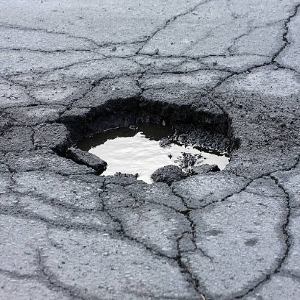

Gray-scale image


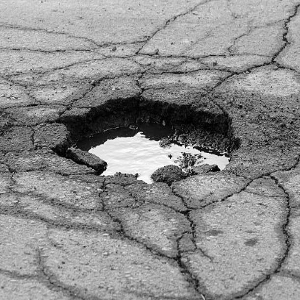

Median image


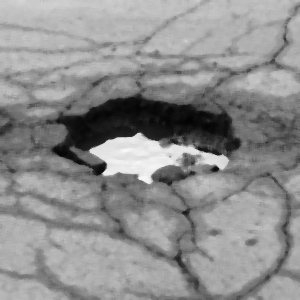

Enchanced image


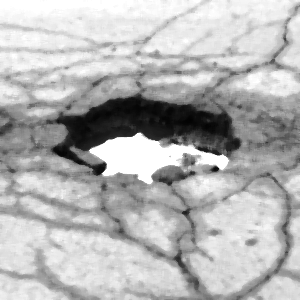

Histogram image


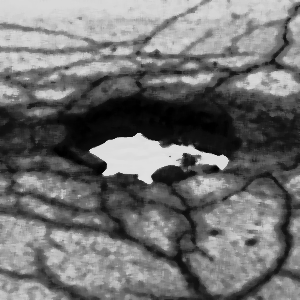

Sharpened image


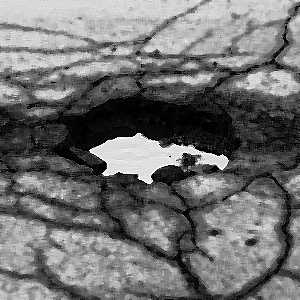

Threshold image


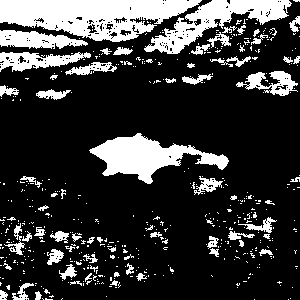

Original image


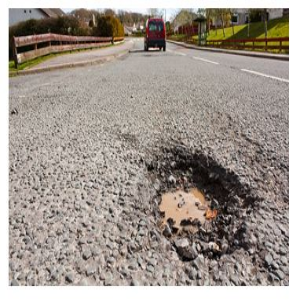

Gray-scale image


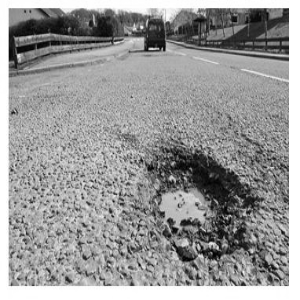

Median image


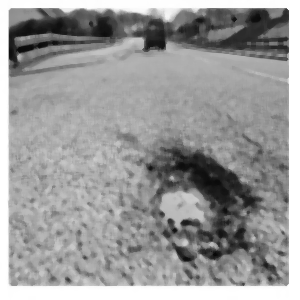

Enchanced image


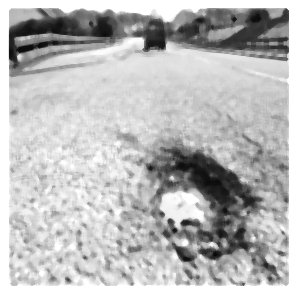

Histogram image


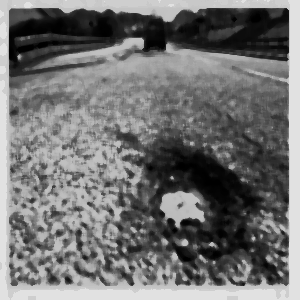

Sharpened image


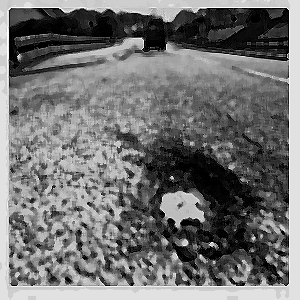

Threshold image


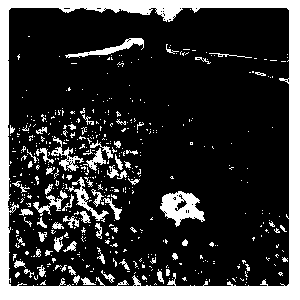

Original image


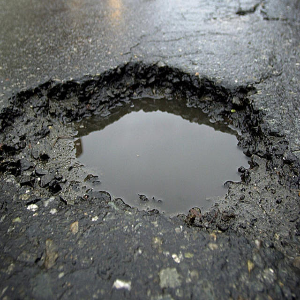

Gray-scale image


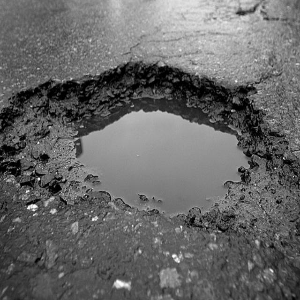

Median image


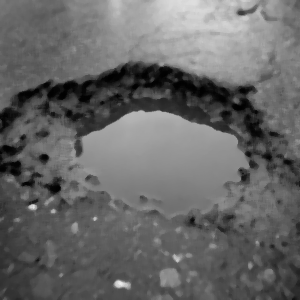

Enchanced image


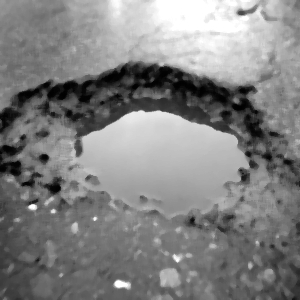

Histogram image


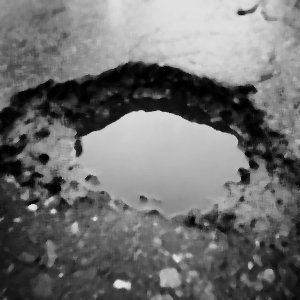

Sharpened image


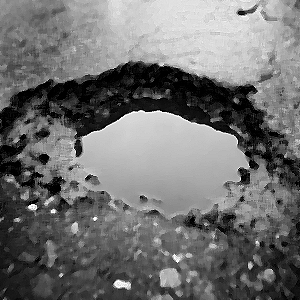

Threshold image


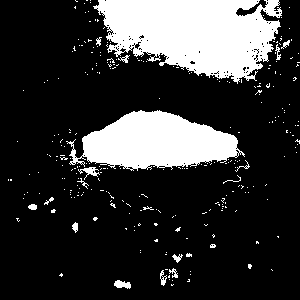

Original image


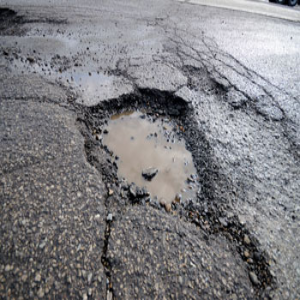

Gray-scale image


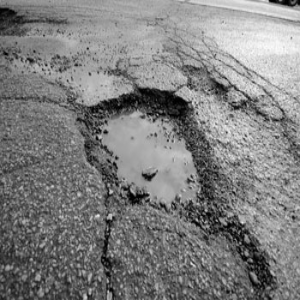

Median image


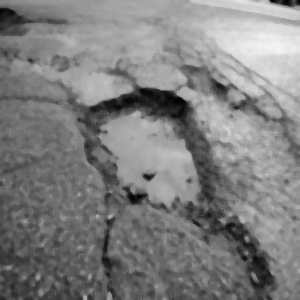

Enchanced image


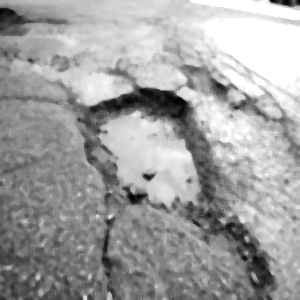

Histogram image


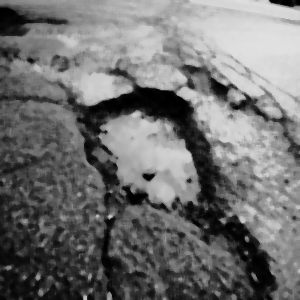

Sharpened image


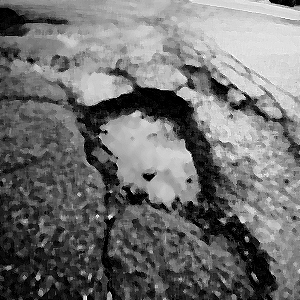

Threshold image


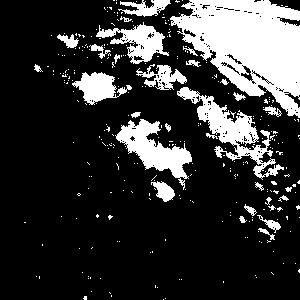

Original image


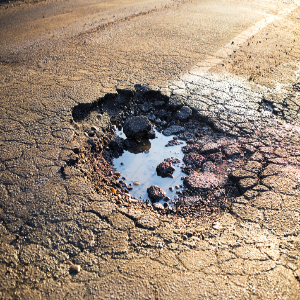

Gray-scale image


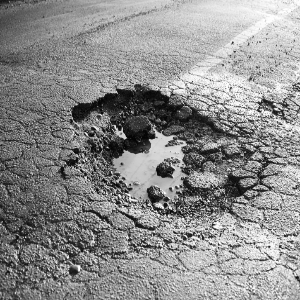

Median image


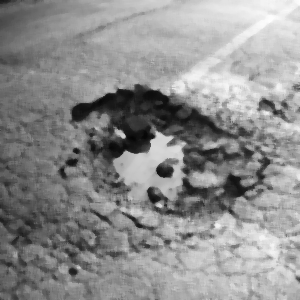

Enchanced image


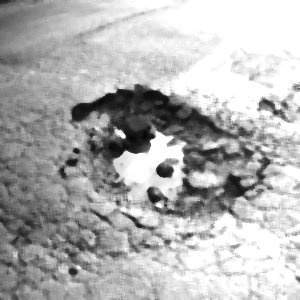

Histogram image


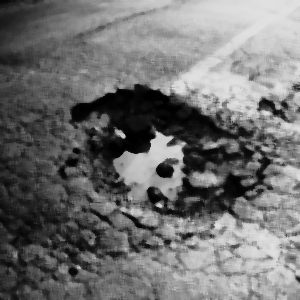

Sharpened image


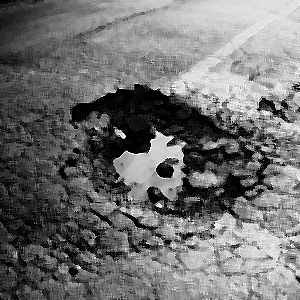

Threshold image


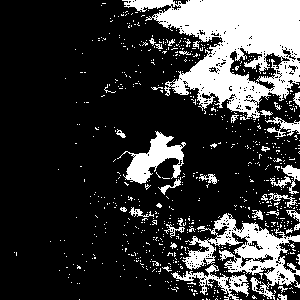

Original image


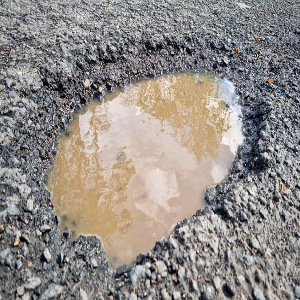

Gray-scale image


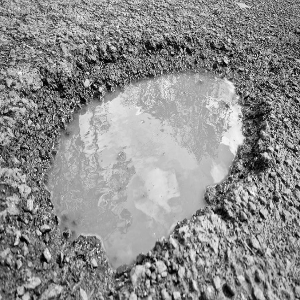

Median image


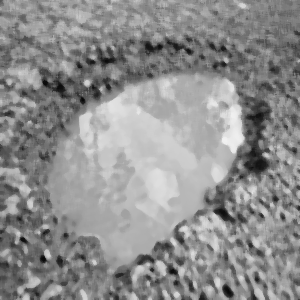

Enchanced image


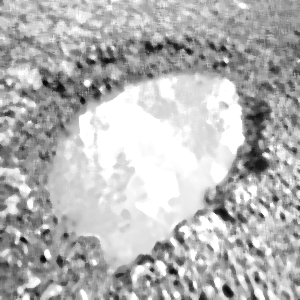

Histogram image


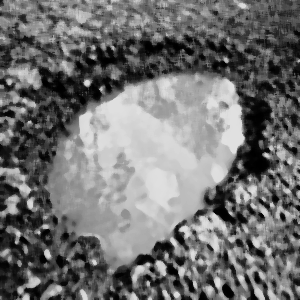

Sharpened image


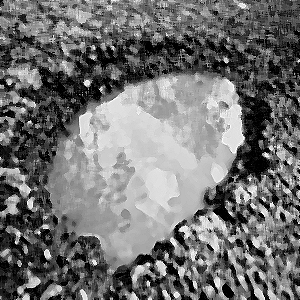

Threshold image


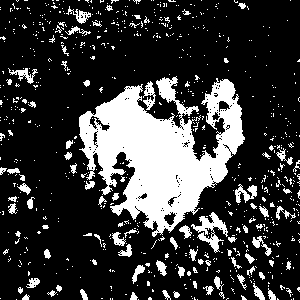

Original image


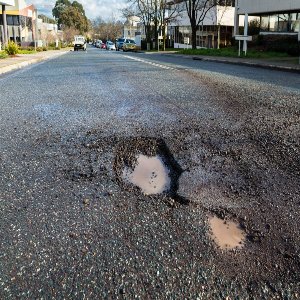

Gray-scale image


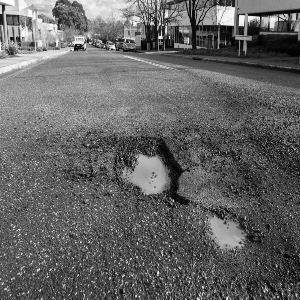

Median image


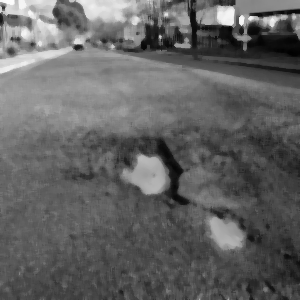

Enchanced image


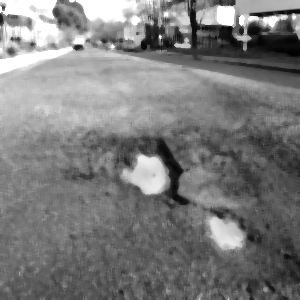

Histogram image


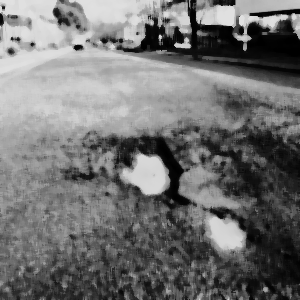

Sharpened image


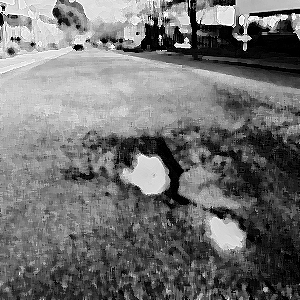

Threshold image


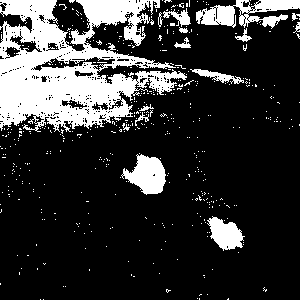

Original image


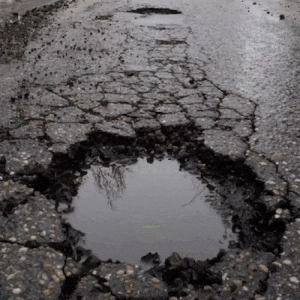

Gray-scale image


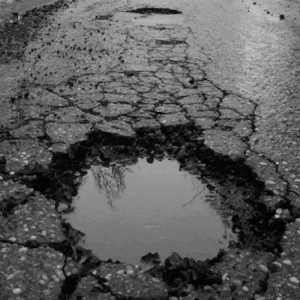

Median image


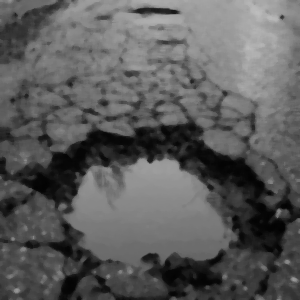

Enchanced image


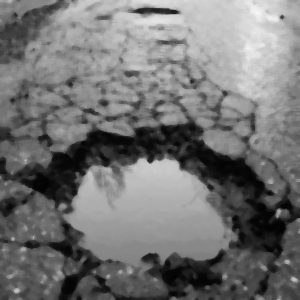

Histogram image


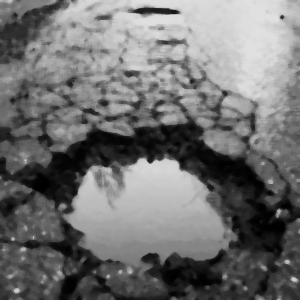

Sharpened image


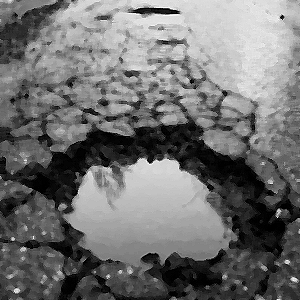

Threshold image


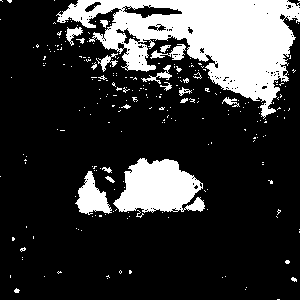

Original image


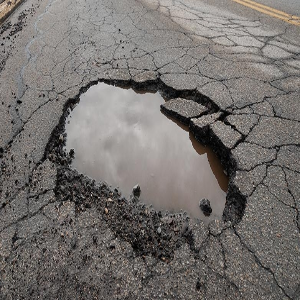

Gray-scale image


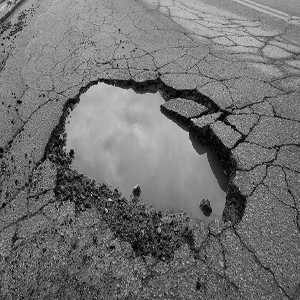

Median image


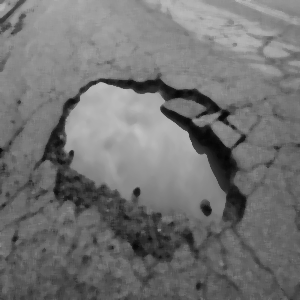

Enchanced image


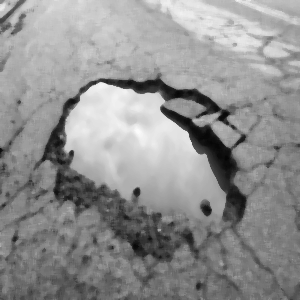

Histogram image


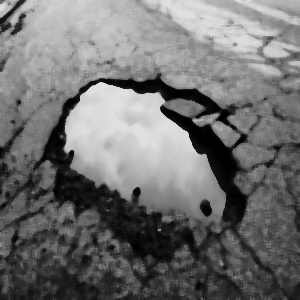

Sharpened image


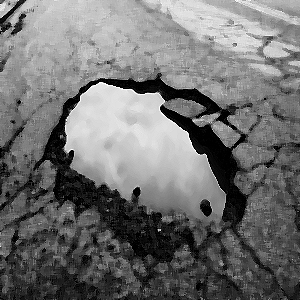

Threshold image


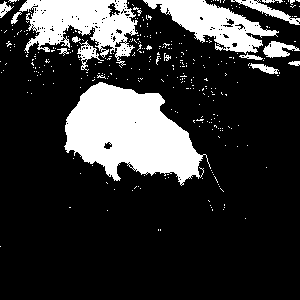

In [50]:

img_dir = "/content/drive/MyDrive/Potholes Dataset" # Enter Directory of all images  
data_path = os.path.join(img_dir,'*jpg') 
files = glob.glob(data_path)
for f1 in files:
    img = cv2.imread(f1)
    # resize image
    img = cv2.resize(img, (300, 300), interpolation = cv2.INTER_LINEAR)
    print("Original image")
    cv2_imshow(img)
    #gray scaling
    gray_image = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    print("Gray-scale image")
    cv2_imshow(gray_image)
    #median filtering
    med_image = median_filter(gray_image,5)
    print("Median image")
    cv2_imshow(med_image)
    #image enhancement using power law transformation
    im_power_law_transformation = 1*pow(med_image,1.05)
    print("Enchanced image")
    cv2_imshow(im_power_law_transformation)
    #histogram equalization
    hist,bins = np.histogram(med_image.flatten(),256,[0,256])
    cdf = hist.cumsum()
    cdf_normalized = cdf * hist.max()/ cdf.max()
    cdf_m = np.ma.masked_equal(cdf,0)
    cdf_m = (cdf_m - cdf_m.min())*225/(cdf_m.max()-cdf_m.min())
    cdf = np.ma.filled(cdf_m,0).astype('uint8')
    img2 = cdf[med_image]
    print("Histogram image")
    cv2_imshow(img2)
    #image sharpening
    lap = cv2.Laplacian(med_image,cv2.CV_64F)
    
    # Calculate the sharpened image
    sharp = img2 - 0.9*lap
    print("Sharpened image")
    cv2_imshow(sharp)
    #thresholding
    ret, thresh1 = cv2.threshold(sharp, 180, 255, cv2.THRESH_BINARY)
    print("Threshold image")
    cv2_imshow(thresh1)

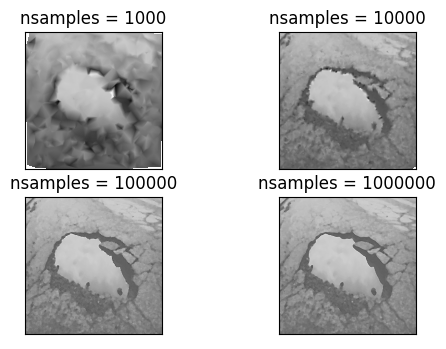

In [51]:
def make_interpolated_image(nsamples):
    ix = np.random.randint(im.shape[1], size=nsamples)
    iy = np.random.randint(im.shape[0], size=nsamples)
    samples = im[iy,ix]
    int_im = griddata((iy, ix), samples, (Y, X)) #interpolation function returns the interpolated grid value
    return int_im

# Read in image and convert to greyscale array object
img_name = sys.argv[1]
img=cv2.imread('/content/drive/MyDrive/Potholes Dataset/6.jpg')
im =asarray(sharp)
# A meshgrid of pixel coordinates
nx, ny = im.shape[1], im.shape[0]
X, Y = np.meshgrid(np.arange(0, nx, 1), np.arange(0, ny, 1)) #convert to rectangular grid from two 1-d arrays

# Create a figure of nrows x ncols subplots, and orient it appropriately
# for the aspect ratio of the image.
nrows, ncols = 2, 2
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(6,4), dpi=100)
if nx < ny:
    w, h = fig.get_figwidth(), fig.get_figheight()
    fig.set_figwidth(h), fig.set_figheight(w)

# Convert an integer i to coordinates in the ax array
get_indices = lambda i: (i // nrows, i % ncols)

# Sample 100, 1,000, 10,000 and 100,000 points and plot the interpolated
# images in the figure
for i in range(4):
    nsamples = 10**(i+3)
    axes = ax[get_indices(i)]
    axes.imshow(make_interpolated_image(nsamples),cmap=plt.get_cmap('Greys_r'))
    axes.set_xticks([])
    axes.set_yticks([])
    axes.set_title('nsamples = {0:d}'.format(nsamples))
filestem = os.path.splitext(os.path.basename(img_name))[0]
plt.savefig('{0:s}_interp.png'.format(filestem), dpi=100)

Reading from dataset and displaying spectrum, centered and decentralized spectrum

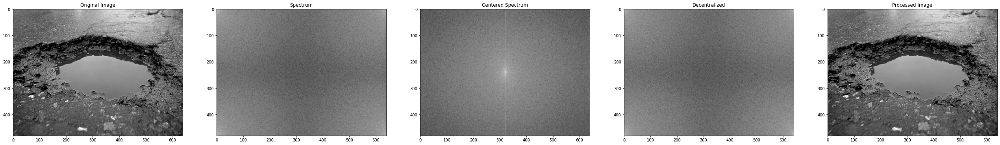

In [52]:
plt.figure(figsize=(6.4*7, 4.8*7), constrained_layout=False)

img = cv2.imread("/content/drive/MyDrive/Potholes Dataset/6.jpg", 0)
plt.subplot(151), plt.imshow(img, "gray"), plt.title("Original Image")

original = np.fft.fft2(img)
plt.subplot(152), plt.imshow(np.log(1+np.abs(original)), "gray"), plt.title("Spectrum")

center = np.fft.fftshift(original)
plt.subplot(153), plt.imshow(np.log(1+np.abs(center)), "gray"), plt.title("Centered Spectrum")

inv_center = np.fft.ifftshift(center)
plt.subplot(154), plt.imshow(np.log(1+np.abs(inv_center)), "gray"), plt.title("Decentralized")

processed_img = np.fft.ifft2(inv_center)
plt.subplot(155), plt.imshow(np.abs(processed_img), "gray"), plt.title("Processed Image")

plt.show()

Displaying the spectrum and phase angle

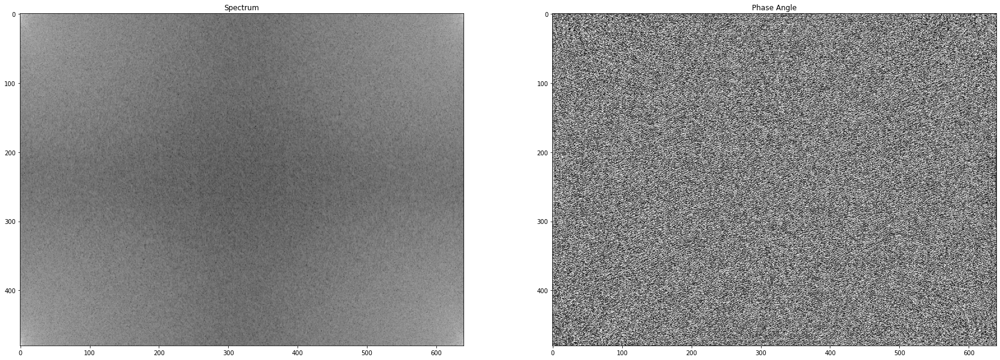

In [53]:
plt.figure(figsize=(6.4*7, 4.8*7), constrained_layout=False)

img = cv2.imread("/content/drive/MyDrive/Potholes Dataset/6.jpg", 0)

original = np.fft.fft2(img)
plt.subplot(131), plt.imshow(np.log(np.abs(original)), "gray"), plt.title("Spectrum")

plt.subplot(132), plt.imshow(np.angle(original), "gray"), plt.title("Phase Angle")
plt.show()

Applying the formulas for all types of Low Pass and High Pass filters

In [54]:
def distance(point1,point2):
    return sqrt((point1[0]-point2[0])**2 + (point1[1]-point2[1])**2)


def idealFilterLP(D0,imgShape):
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
            if distance((y,x),center) < D0:
                base[y,x] = 1
    return base

def idealFilterHP(D0,imgShape):
    base = np.ones(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
            if distance((y,x),center) < D0:
                base[y,x] = 0
    return base

def gaussianLP(D0,imgShape):
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
            base[y,x] = exp(((-distance((y,x),center)**2)/(2*(D0**2))))
    return base

def gaussianHP(D0,imgShape):
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
            base[y,x] = 1 - exp(((-distance((y,x),center)**2)/(2*(D0**2))))
    return base
      
def butterworthLP(D0,imgShape,n):
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
            base[y,x] = 1/(1+(distance((y,x),center)/D0)**(2*n))
    return base

def butterworthHP(D0,imgShape,n):
    base = np.zeros(imgShape[:2])
    rows, cols = imgShape[:2]
    center = (rows/2,cols/2)
    for x in range(cols):
        for y in range(rows):
            base[y,x] = 1-1/(1+(distance((y,x),center)/D0)**(2*n))
    return base

Ideal Low Pass Filter

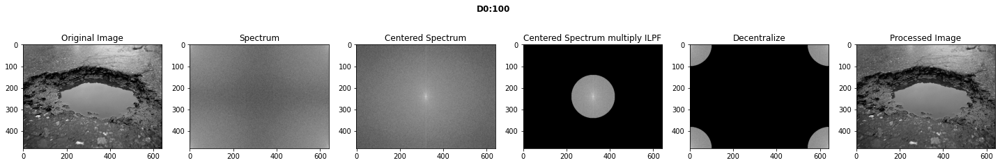

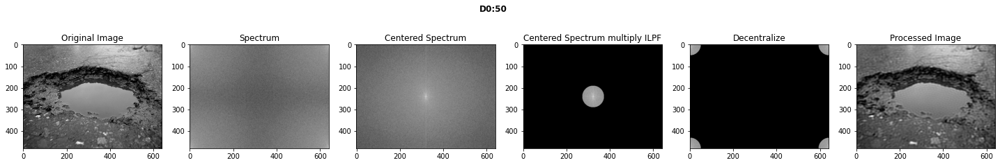

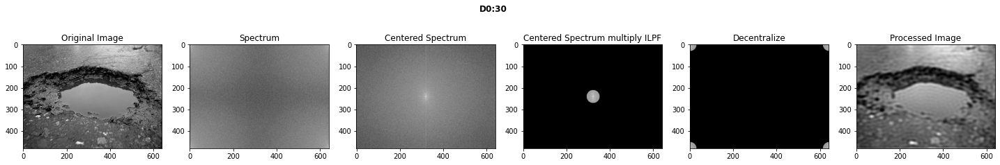

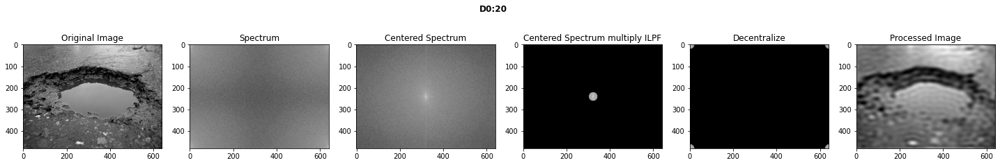

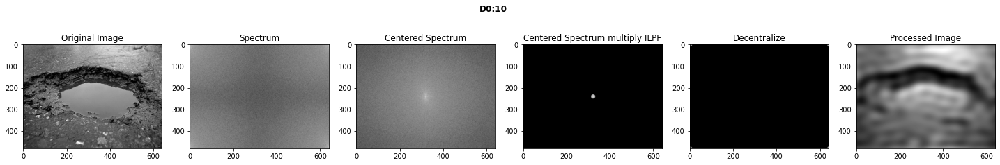

In [55]:
def try_d0s_lp(d0):
    plt.figure(figsize=(25, 5), constrained_layout=False)


    plt.subplot(161), plt.imshow(img, "gray"), plt.title("Original Image")

    original = np.fft.fft2(img)
    plt.subplot(162), plt.imshow(np.log(1+np.abs(original)), "gray"), plt.title("Spectrum")

    center = np.fft.fftshift(original)
    plt.subplot(163), plt.imshow(np.log(1+np.abs(center)), "gray"), plt.title("Centered Spectrum")

    LowPassCenter = center * idealFilterLP(d0,img.shape)
    plt.subplot(164), plt.imshow(np.log(1+np.abs(LowPassCenter)), "gray"), plt.title("Centered Spectrum multiply ILPF")

    LowPass = np.fft.ifftshift(LowPassCenter)
    plt.subplot(165), plt.imshow(np.log(1+np.abs(LowPass)), "gray"), plt.title("Decentralize")

    inverse_LowPass = np.fft.ifft2(LowPass)
    plt.subplot(166), plt.imshow(np.abs(inverse_LowPass), "gray"), plt.title("Processed Image")

    plt.suptitle("D0:"+str(d0),fontweight="bold")
    plt.subplots_adjust(top=1.1)
    plt.show()
    
    
for i in [100,50,30,20,10]:
    try_d0s_lp(i)

Gaussian Low Pass Filter

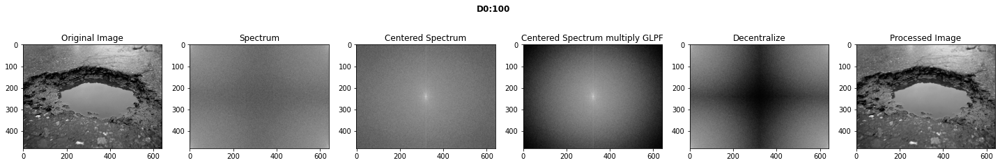

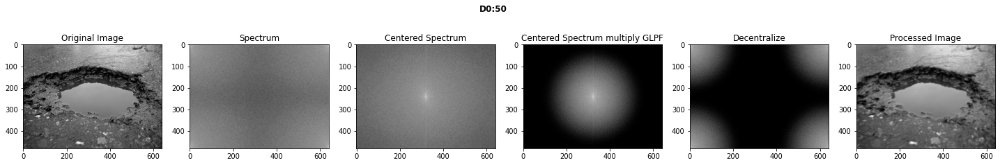

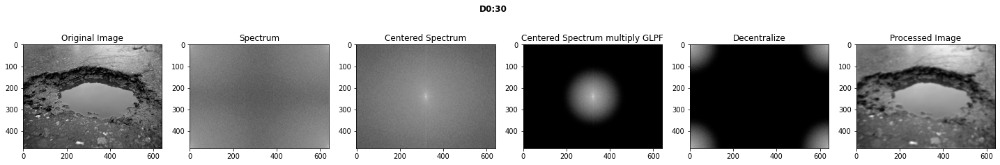

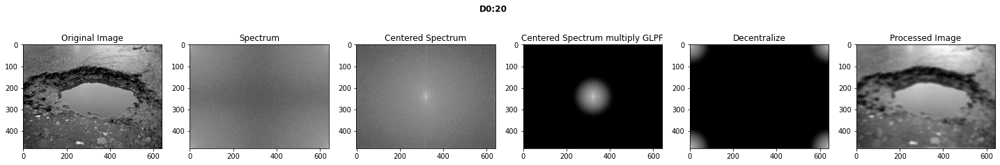

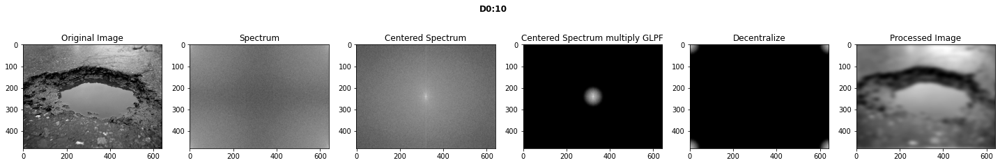

In [56]:
def try_d0s_lp(d0):
    plt.figure(figsize=(25, 5), constrained_layout=False)


    plt.subplot(161), plt.imshow(img, "gray"), plt.title("Original Image")

    original = np.fft.fft2(img)
    plt.subplot(162), plt.imshow(np.log(1+np.abs(original)), "gray"), plt.title("Spectrum")

    center = np.fft.fftshift(original)
    plt.subplot(163), plt.imshow(np.log(1+np.abs(center)), "gray"), plt.title("Centered Spectrum")

    LowPassCenter = center * gaussianLP(d0,img.shape)
    plt.subplot(164), plt.imshow(np.log(1+np.abs(LowPassCenter)), "gray"), plt.title("Centered Spectrum multiply GLPF")

    LowPass = np.fft.ifftshift(LowPassCenter)
    plt.subplot(165), plt.imshow(np.log(1+np.abs(LowPass)), "gray"), plt.title("Decentralize")

    inverse_LowPass = np.fft.ifft2(LowPass)
    plt.subplot(166), plt.imshow(np.abs(inverse_LowPass), "gray"), plt.title("Processed Image")

    plt.suptitle("D0:"+str(d0),fontweight="bold")
    plt.subplots_adjust(top=1.1)
    plt.show()
    
    
for i in [100,50,30,20,10]:
    try_d0s_lp(i)

Butterworth Low Pass Filter

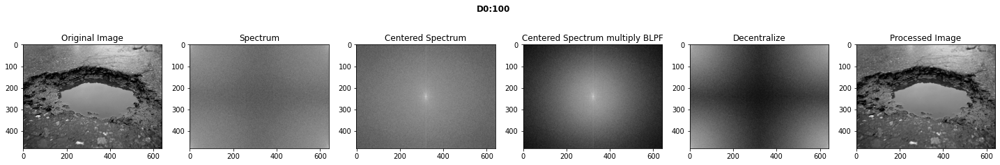

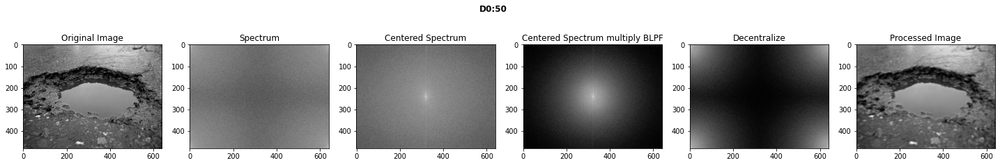

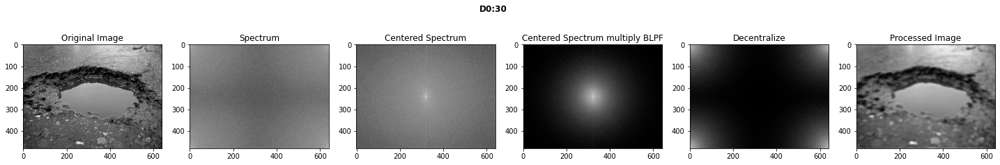

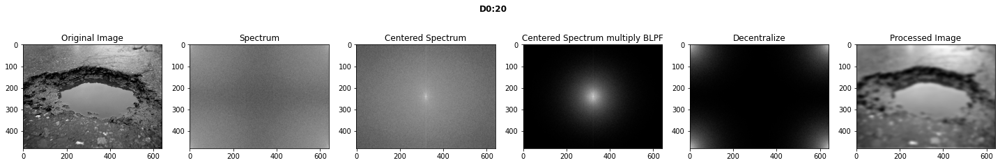

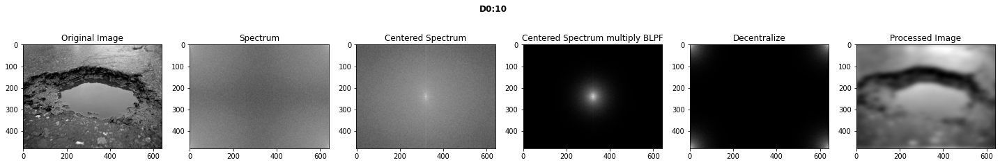

In [57]:
def try_d0s_lp(d0):
    plt.figure(figsize=(25, 5), constrained_layout=False)


    plt.subplot(161), plt.imshow(img, "gray"), plt.title("Original Image")

    original = np.fft.fft2(img)
    plt.subplot(162), plt.imshow(np.log(1+np.abs(original)), "gray"), plt.title("Spectrum")

    center = np.fft.fftshift(original)
    plt.subplot(163), plt.imshow(np.log(1+np.abs(center)), "gray"), plt.title("Centered Spectrum")

    LowPassCenter = center * butterworthLP(d0,img.shape,2)
    plt.subplot(164), plt.imshow(np.log(1+np.abs(LowPassCenter)), "gray"), plt.title("Centered Spectrum multiply BLPF")

    LowPass = np.fft.ifftshift(LowPassCenter)
    plt.subplot(165), plt.imshow(np.log(1+np.abs(LowPass)), "gray"), plt.title("Decentralize")

    inverse_LowPass = np.fft.ifft2(LowPass)
    plt.subplot(166), plt.imshow(np.abs(inverse_LowPass), "gray"), plt.title("Processed Image")

    plt.suptitle("D0:"+str(d0),fontweight="bold")
    plt.subplots_adjust(top=1.1)
    plt.show()
    
    
for i in [100,50,30,20,10]:
    try_d0s_lp(i)

Setting D0=50 : Low Pass Filters

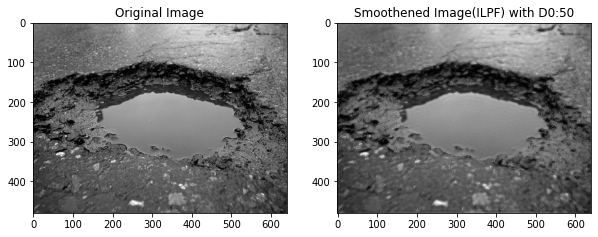

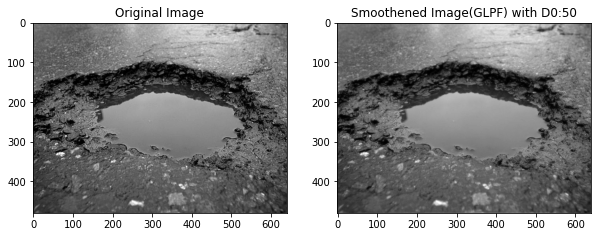

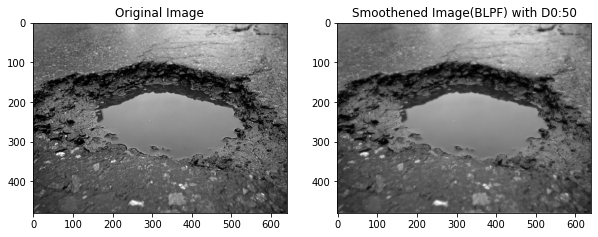

In [58]:
d0 = 50
# perform FFT
original = np.fft.fft2(img)
# get spectrum
center = np.fft.fftshift(original)
# center spectrum for high pass
HighPassCenter = center * idealFilterLP(d0,img.shape)
# perform high pass
HighPass = np.fft.ifftshift(HighPassCenter)
# reverse FFT -> IFFT
inverse_HighPass = np.fft.ifft2(HighPass)
# add filter to original image
smooth= img+np.abs(inverse_HighPass)


plt.figure(figsize=(10, 10))
plt.subplot(121)
plt.imshow(img, "gray")
plt.title("Original Image")

plt.subplot(122)
plt.imshow(smooth,cmap="gray")
plt.title("Smoothened Image(ILPF) with D0:"+str(d0))
plt.show()

# perform FFT
original = np.fft.fft2(img)
# get spectrum
center = np.fft.fftshift(original)
# center spectrum for high pass
HighPassCenter = center * gaussianLP(d0,img.shape)
# perform high pass
HighPass = np.fft.ifftshift(HighPassCenter)
# reverse FFT -> IFFT
inverse_HighPass = np.fft.ifft2(HighPass)
# add filter to original image
smooth_s = img+np.abs(inverse_HighPass)


plt.figure(figsize=(10, 10))
plt.subplot(121)
plt.imshow(img, "gray")
plt.title("Original Image")

plt.subplot(122)
plt.imshow(smooth_s,cmap="gray")
plt.title("Smoothened Image(GLPF) with D0:"+str(d0))
plt.show()

# perform FFT
original = np.fft.fft2(img)
# get spectrum
center = np.fft.fftshift(original)
# center spectrum for high pass
HighPassCenter = center * butterworthLP(d0,img.shape,2)
# perform high pass
HighPass = np.fft.ifftshift(HighPassCenter)
# reverse FFT -> IFFT
inverse_HighPass = np.fft.ifft2(HighPass)
# add filter to original image
smooth = img+np.abs(inverse_HighPass)


plt.figure(figsize=(10, 10))
plt.subplot(121)
plt.imshow(img, "gray")
plt.title("Original Image")

plt.subplot(122)
plt.imshow(smooth,cmap="gray")
plt.title("Smoothened Image(BLPF) with D0:"+str(d0))
plt.show()

Ideal High Pass Filter

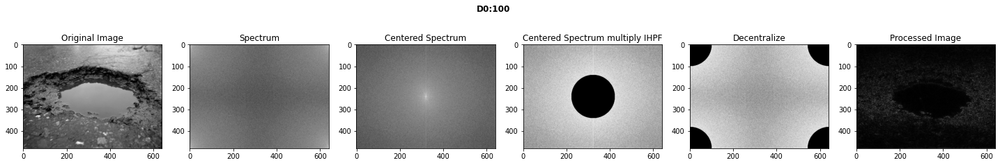

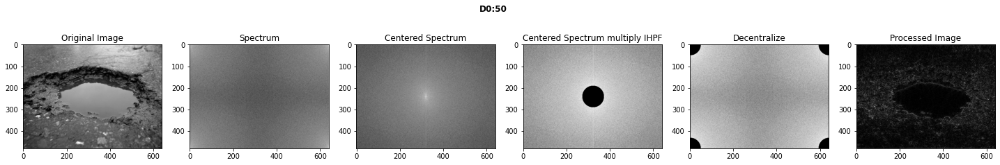

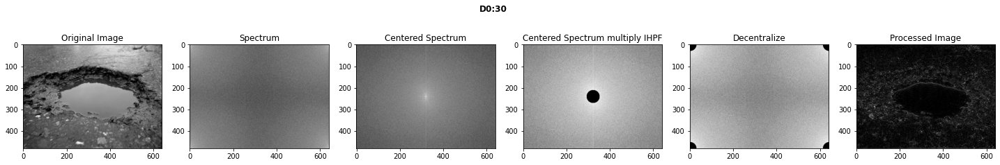

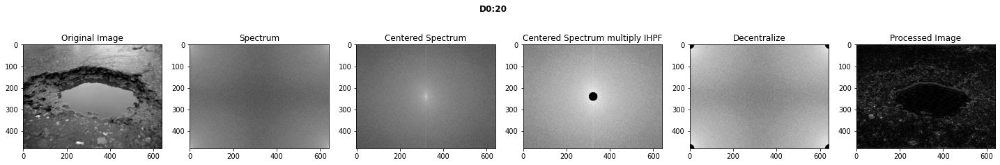

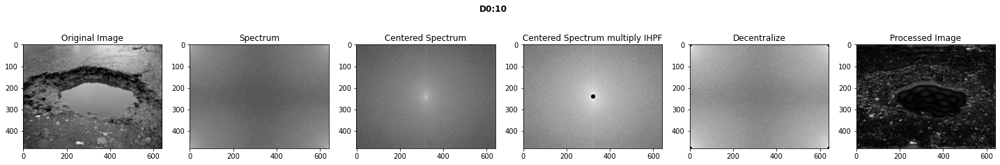

In [59]:
def try_d0s_hp(d0):
    plt.figure(figsize=(25, 5), constrained_layout=False)


    plt.subplot(161), plt.imshow(smooth_s, "gray"), plt.title("Original Image")

    original = np.fft.fft2(smooth_s)
    plt.subplot(162), plt.imshow(np.log(1+np.abs(original)), "gray"), plt.title("Spectrum")

    center = np.fft.fftshift(original)
    plt.subplot(163), plt.imshow(np.log(1+np.abs(center)), "gray"), plt.title("Centered Spectrum")

    HighPassCenter = center * idealFilterHP(d0,smooth_s.shape)
    plt.subplot(164), plt.imshow(np.log(1+np.abs(HighPassCenter)), "gray"), plt.title("Centered Spectrum multiply IHPF")

    HighPass = np.fft.ifftshift(HighPassCenter)
    plt.subplot(165), plt.imshow(np.log(1+np.abs(HighPass)), "gray"), plt.title("Decentralize")

    inverse_HighPass = np.fft.ifft2(HighPass)
    plt.subplot(166), plt.imshow(np.abs(inverse_HighPass), "gray"), plt.title("Processed Image")

    plt.suptitle("D0:"+str(d0),fontweight="bold")
    plt.subplots_adjust(top=1.1)
    plt.show()
    
    
for i in [100,50,30,20,10]:
    try_d0s_hp(i)

Gaussian High Pass Filter

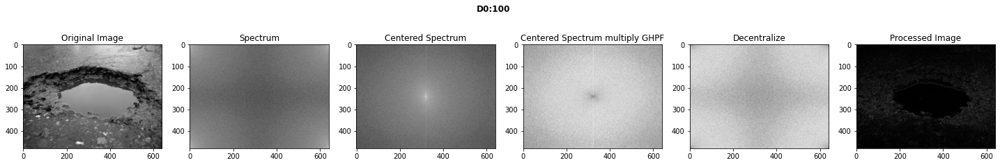

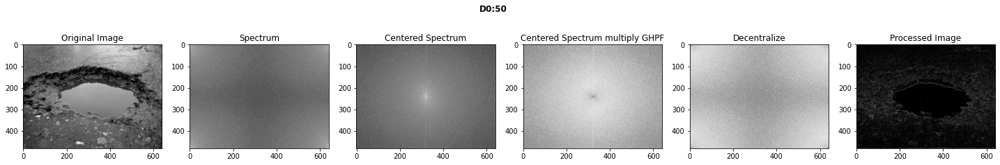

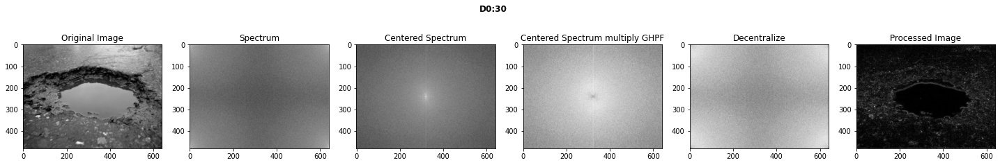

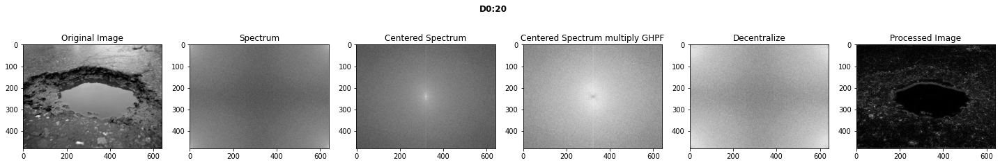

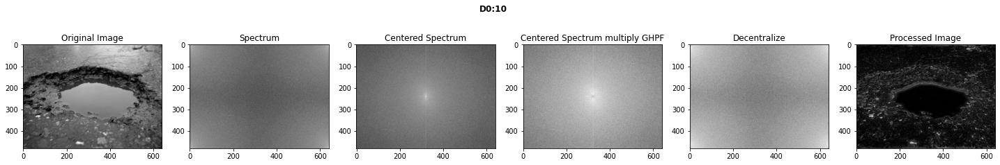

In [60]:
def try_d0s_hp(d0):
    plt.figure(figsize=(25, 5), constrained_layout=False)


    plt.subplot(161), plt.imshow(smooth_s, "gray"), plt.title("Original Image")

    original = np.fft.fft2(smooth_s)
    plt.subplot(162), plt.imshow(np.log(1+np.abs(original)), "gray"), plt.title("Spectrum")

    center = np.fft.fftshift(original)
    plt.subplot(163), plt.imshow(np.log(1+np.abs(center)), "gray"), plt.title("Centered Spectrum")

    HighPassCenter = center * gaussianHP(d0,smooth_s.shape)
    plt.subplot(164), plt.imshow(np.log(1+np.abs(HighPassCenter)), "gray"), plt.title("Centered Spectrum multiply GHPF")

    HighPass = np.fft.ifftshift(HighPassCenter)
    plt.subplot(165), plt.imshow(np.log(1+np.abs(HighPass)), "gray"), plt.title("Decentralize")

    inverse_HighPass = np.fft.ifft2(HighPass)
    plt.subplot(166), plt.imshow(np.abs(inverse_HighPass), "gray"), plt.title("Processed Image")

    plt.suptitle("D0:"+str(d0),fontweight="bold")
    plt.subplots_adjust(top=1.1)
    plt.show()
    
    
for i in [100,50,30,20,10]:
    try_d0s_hp(i)

Butterworth High Pass Filter

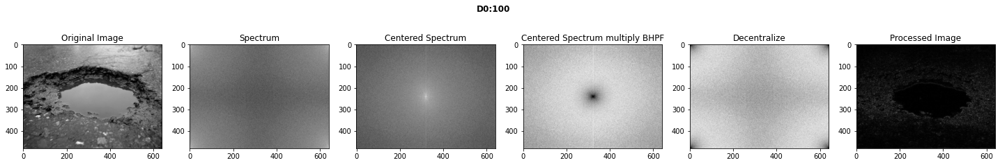

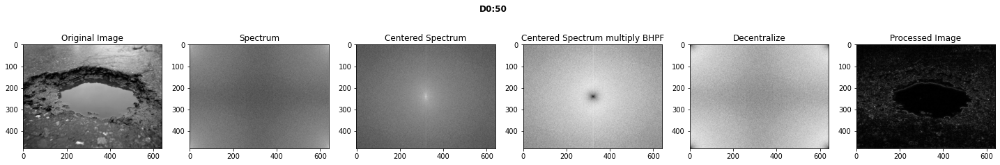

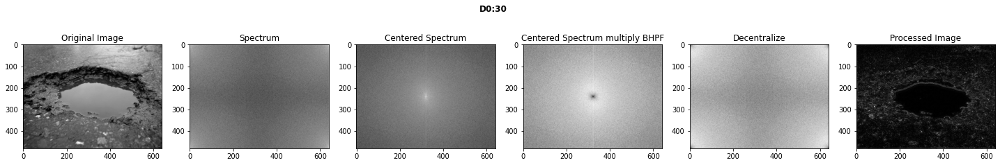

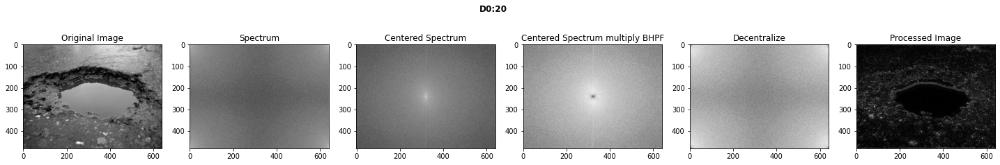

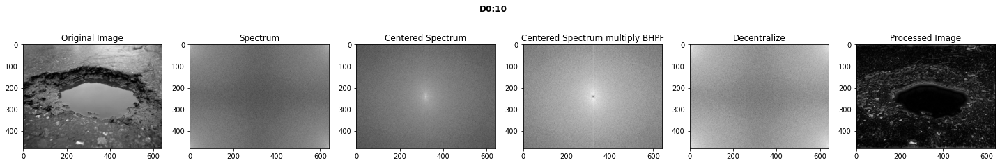

In [61]:
def try_d0s_hp(d0):
    plt.figure(figsize=(25, 5), constrained_layout=False)


    plt.subplot(161), plt.imshow(smooth_s, "gray"), plt.title("Original Image")

    original = np.fft.fft2(smooth_s)
    plt.subplot(162), plt.imshow(np.log(1+np.abs(original)), "gray"), plt.title("Spectrum")

    center = np.fft.fftshift(original)
    plt.subplot(163), plt.imshow(np.log(1+np.abs(center)), "gray"), plt.title("Centered Spectrum")

    HighPassCenter = center * butterworthHP(d0,smooth_s.shape,2)
    plt.subplot(164), plt.imshow(np.log(1+np.abs(HighPassCenter)), "gray"), plt.title("Centered Spectrum multiply BHPF")

    HighPass = np.fft.ifftshift(HighPassCenter)
    plt.subplot(165), plt.imshow(np.log(1+np.abs(HighPass)), "gray"), plt.title("Decentralize")

    inverse_HighPass = np.fft.ifft2(HighPass)
    plt.subplot(166), plt.imshow(np.abs(inverse_HighPass), "gray"), plt.title("Processed Image")

    plt.suptitle("D0:"+str(d0),fontweight="bold")
    plt.subplots_adjust(top=1.1)
    plt.show()
    
    
for i in [100,50,30,20,10]:
    try_d0s_hp(i)

Setting D0=10 : High Pass Filters

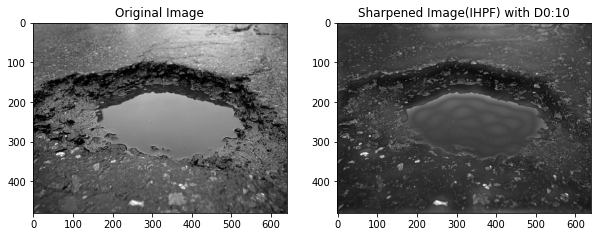

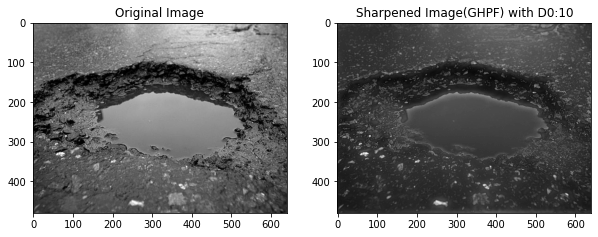

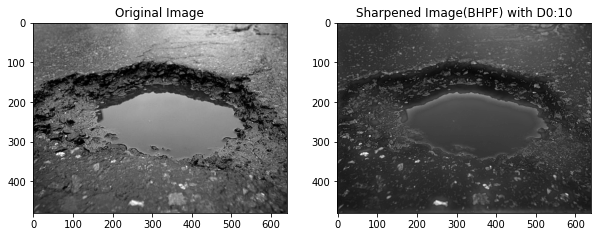

In [62]:
d0 = 10
# perform FFT
original = np.fft.fft2(smooth_s)
# get spectrum
center = np.fft.fftshift(original)
# center spectrum for high pass
HighPassCenter = center * idealFilterHP(d0,smooth_s.shape)
# perform high pass
HighPass = np.fft.ifftshift(HighPassCenter)
# reverse FFT -> IFFT
inverse_HighPass = np.fft.ifft2(HighPass)
# add filter to original image
sharpened = img+np.abs(inverse_HighPass)


plt.figure(figsize=(10, 10))
plt.subplot(121)
plt.imshow(img, "gray")
plt.title("Original Image")

plt.subplot(122)
plt.imshow(sharpened,cmap="gray")
plt.title("Sharpened Image(IHPF) with D0:"+str(d0))
plt.show()

# perform FFT
original = np.fft.fft2(smooth_s)
# get spectrum
center = np.fft.fftshift(original)
# center spectrum for high pass
HighPassCenter = center * gaussianHP(d0,smooth_s.shape)
# perform high pass
HighPass = np.fft.ifftshift(HighPassCenter)
# reverse FFT -> IFFT
inverse_HighPass = np.fft.ifft2(HighPass)
# add filter to original image
sharpened = img+np.abs(inverse_HighPass)


plt.figure(figsize=(10, 10))
plt.subplot(121)
plt.imshow(img, "gray")
plt.title("Original Image")

plt.subplot(122)
plt.imshow(sharpened,cmap="gray")
plt.title("Sharpened Image(GHPF) with D0:"+str(d0))
plt.show()

# perform FFT
original = np.fft.fft2(smooth_s)
# get spectrum
center = np.fft.fftshift(original)
# center spectrum for high pass
HighPassCenter = center * butterworthHP(d0,smooth_s.shape,2)
# perform high pass
HighPass = np.fft.ifftshift(HighPassCenter)
# reverse FFT -> IFFT
inverse_HighPass = np.fft.ifft2(HighPass)
# add filter to original image
sharpened_h = img+np.abs(inverse_HighPass)


plt.figure(figsize=(10, 10))
plt.subplot(121)
plt.imshow(img, "gray")
plt.title("Original Image")

plt.subplot(122)
plt.imshow(sharpened_h,cmap="gray")
plt.title("Sharpened Image(BHPF) with D0:"+str(d0))
plt.show()

Laplacian, Sobel Filtering Technique

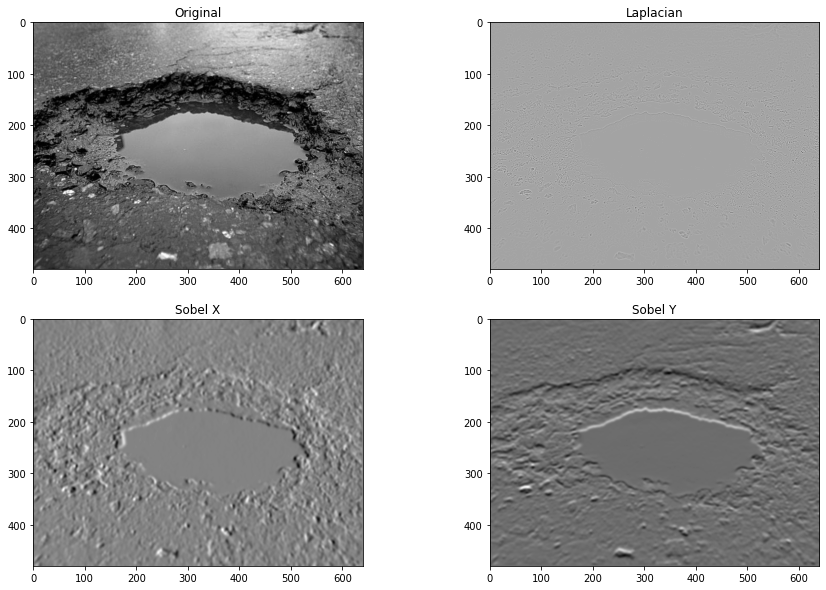

In [63]:
laplacian = cv2.Laplacian(sharpened_h,cv2.CV_64F)
sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=21)
sobely = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=21)

plt.figure(figsize=(15, 10))
plt.subplot(2,2,1)
plt.imshow(img, cmap = 'gray')
plt.title('Original')
plt.subplot(2,2,2),plt.imshow(laplacian,cmap = 'gray')
plt.title('Laplacian')
plt.subplot(2,2,3)
plt.imshow(sobelx,cmap = 'gray')
plt.title('Sobel X')
plt.subplot(2,2,4)
plt.imshow(sobely,cmap = 'gray')
plt.title('Sobel Y')

plt.show()

Thresholding of Laplacian and Sobel

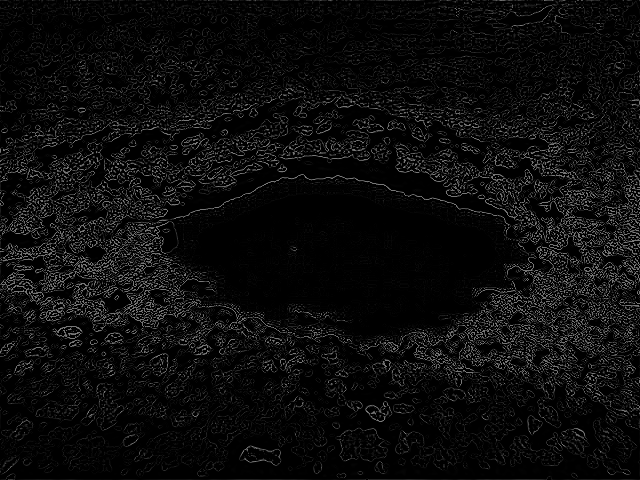

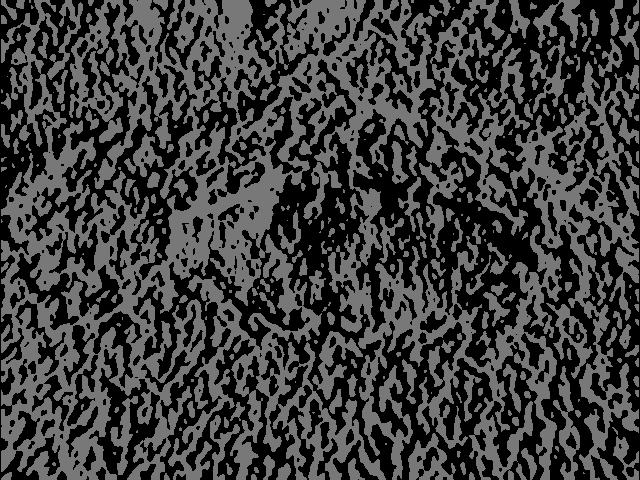

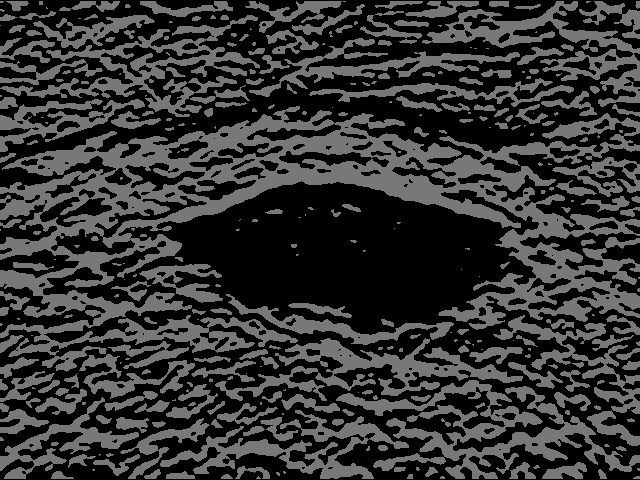

In [64]:
from google.colab.patches import cv2_imshow
ret, thresh1= cv2.threshold(laplacian, 120, 255, cv2.THRESH_TRUNC)
ret, thresh2= cv2.threshold(sobelx, 120, 255, cv2.THRESH_TRUNC)
ret, thresh3= cv2.threshold(sobely, 120, 255, cv2.THRESH_TRUNC)
cv2_imshow(thresh1)
cv2_imshow(thresh2)
cv2_imshow(thresh3)
# De-allocate any associated memory usage
if cv2.waitKey(0) & 0xff == 27:
	cv2.destroyAllWindows()


Unsharp Masking and High Boost Filtering

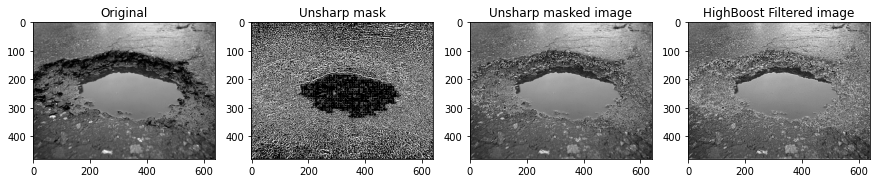

In [65]:
from skimage import data
from skimage import img_as_ubyte, img_as_int
from scipy import ndimage

low_pass = (1/9)*np.array([[1, 1, 1], [1, 1, 1], [1, 1, 1]], dtype='float64') #LP mask
blurred = ndimage.convolve(img, low_pass, mode='constant', cval=0.0)
unsharp_mask = img_as_ubyte(img - blurred)
unsharp = img_as_ubyte(img + 1*unsharp_mask)
highboost=img_as_ubyte(img + 3*unsharp_mask)

plt.figure(figsize=(15,5))
plt.subplot(1, 4, 1)
plt.title('Original')
plt.imshow(img,cmap="gray")
plt.subplot(1, 4, 2)
plt.title('Unsharp mask')
plt.imshow(unsharp_mask,cmap="gray")
plt.subplot(1, 4, 3)
plt.title('Unsharp masked image')
plt.imshow(unsharp,cmap="gray")
plt.subplot(1, 4, 4)
plt.title('HighBoost Filtered image')
plt.imshow(highboost,cmap="gray")

Frequency Domain Filtering VS Spatial Domain Filtering

Frequency threshold


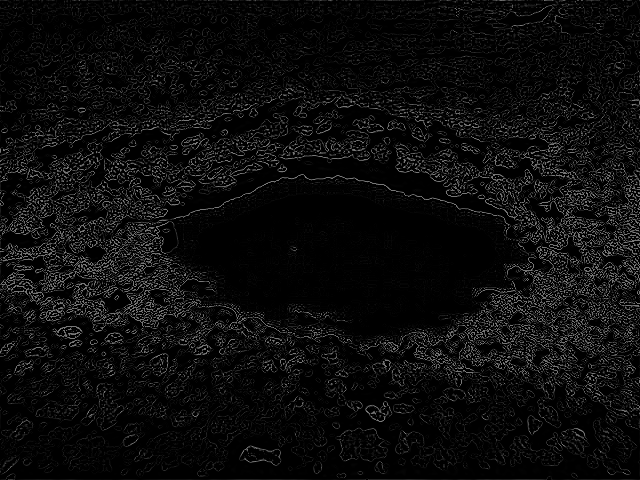

Spatial threshold


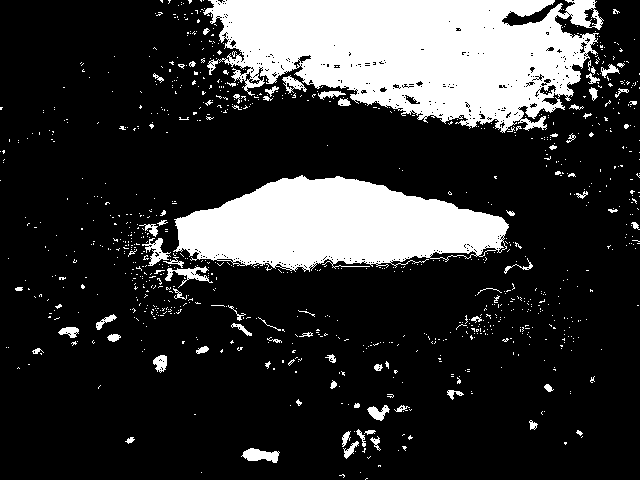

In [66]:
#comparison of Frequency domain filtering vs Spacial Domain Filtering
ret, thresh= cv2.threshold(laplacian, 120, 255, cv2.THRESH_TRUNC)
print("Frequency threshold")
cv2_imshow(thresh)
#spatial image
med_image = median_filter(img,5)
hist,bins = np.histogram(med_image.flatten(),256,[0,256])
cdf = hist.cumsum()
cdf_normalized = cdf * hist.max()/ cdf.max()
cdf_m = np.ma.masked_equal(cdf,0)
cdf_m = (cdf_m - cdf_m.min())*225/(cdf_m.max()-cdf_m.min())
cdf = np.ma.filled(cdf_m,0).astype('uint8')
img2 = cdf[med_image]
lap = cv2.Laplacian(med_image,cv2.CV_64F)
sharp = img2 - 0.9*lap
ret, thresh1 = cv2.threshold(sharp, 180, 255, cv2.THRESH_BINARY)
print("Spatial threshold")
cv2_imshow(thresh1)

1) Periodic Noise

Text(0.5, 1.0, 'Spectrum')

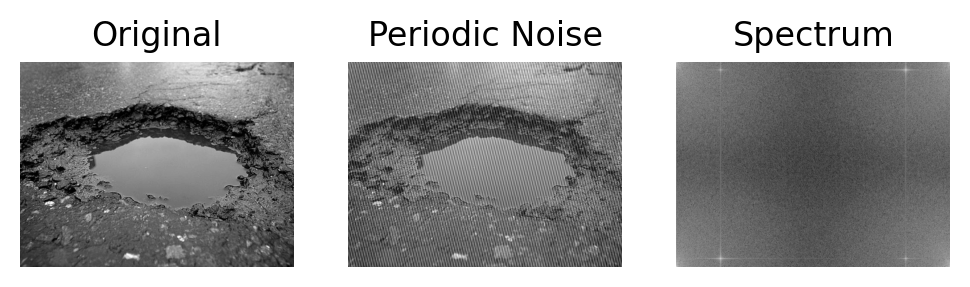

In [67]:
#noise
def add_periodic(img):
    orig = img
    sh = orig.shape[0], orig.shape[1]
    noise = np.zeros(sh, dtype='float64')
    X, Y = np.meshgrid(range(0, sh[1]), range(0, sh[0]))
    #print(X.shape,Y.shape)
    A = 50
    u0 = 45
    v0 = 50
    noise += A*np.sin(X*u0 + Y*v0)

    A = -18
    u0 = -45
    v0 = 50

    noise += A*np.sin(X*u0 + Y*v0)

    noiseada = orig+noise
    return(noiseada)
periodic = add_periodic(img).astype(int)
original = np.fft.fft2(periodic)


fig=plt.figure(dpi=200)

fig.add_subplot(1,3,1)
plt.imshow(img,cmap='gray')
plt.axis("off")
plt.title("Original")

fig.add_subplot(1,3,2)
plt.imshow(periodic,cmap='gray')
plt.axis("off")
plt.title("Periodic Noise")

fig.add_subplot(1,3,3)
plt.imshow(np.log(1 + np.abs(original)),cmap='gray')
plt.axis("off")
plt.title("Spectrum")

Notch Filtering to remove periodic noise

<ipython-input-68-df963065560f>:21: ComplexWarning: Casting complex values to real discards the imaginary part
  plt.imshow((20*np.log10( 0.1 + F2)).astype(int), cmap=plt.cm.gray)


Text(0.5, 1.0, 'Recovered image')

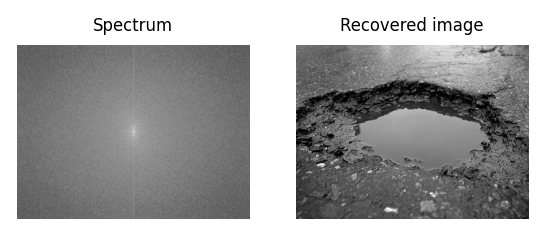

In [68]:
from scipy import fftpack #notch
import numpy.fft as fp
w = 10
h = 10

im = img
F1 = fftpack.fft2((im).astype(float))
F2 = fftpack.fftshift(F1)
for i in range(60, w, 135):
    for j in range(100, h, 200):
        if not (i == 330 and j == 500):
            F2[i-10:i+10, j-10:j+10] = 0
    for i in range(0, w, 135):
        for j in range(200, h, 200):
            if not (i == 330 and j == 500):
                F2[max(0,i-15):min(w,i+15), max(0,j-15):min(h,j+15)] = 0

fig=plt.figure(dpi=170)

fig.add_subplot(1,3,1)
plt.imshow((20*np.log10( 0.1 + F2)).astype(int), cmap=plt.cm.gray)
plt.axis("off")
plt.title("Spectrum",fontsize=7)
#plt.show()
im1 = fp.ifft2(fftpack.ifftshift(F2)).real

fig.add_subplot(1,3,2)
plt.imshow(im1, cmap='gray')
plt.axis("off")
plt.title("Recovered image",fontsize=7)

2) Salt and Pepper Noise (Impulse)

Text(0.5, 1.0, 'median filter')

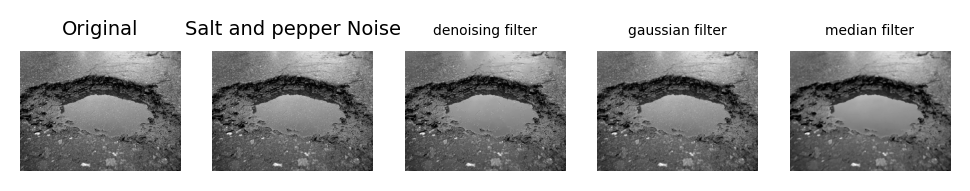

In [69]:
import random

def add_noise(img):

	# Getting the dimensions of the image
	row,col = img.shape
	
	# Randomly pick some pixels in the
	# image for coloring them white
	# Pick a random number between 300 and 10000
	number_of_pixels = random.randint(300, 10000)
	for i in range(number_of_pixels):
	
		# Pick a random y coordinate
		y_coord=random.randint(0, row - 1)
		
		# Pick a random x coordinate
		x_coord=random.randint(0, col - 1)
		
		# Color that pixel to white
		img[y_coord][x_coord] = 255
		
	# Randomly pick some pixels in
	# the image for coloring them black
	# Pick a random number between 300 and 10000
	number_of_pixels = random.randint(300 , 10000)
	for i in range(number_of_pixels):
	
		# Pick a random y coordinate
		y_coord=random.randint(0, row - 1)
		
		# Pick a random x coordinate
		x_coord=random.randint(0, col - 1)
		
		# Color that pixel to black
		img[y_coord][x_coord] = 0
		
	return img

# salt-and-pepper noise can
# be applied only to grayscale images
# Reading the color image in grayscale image
imx=img
#Storing the image
im=add_noise(imx)
#denoising
new_image = cv2.fastNlMeansDenoising(im,None,10,10)
blurred22=cv2.GaussianBlur(im,(3,3),1)
med = cv2.medianBlur(im,5)

fig=plt.figure(dpi=200)

fig.add_subplot(1,5,1)
plt.imshow(img,cmap='gray')
plt.axis("off")
plt.title("Original",fontsize=7)

fig.add_subplot(1,5,2)
plt.imshow(im,cmap='gray')
plt.axis("off")
plt.title("Salt and pepper Noise",fontsize=7)

fig.add_subplot(1,5,3)
plt.imshow(new_image,cmap='gray')
plt.axis("off")
plt.title("denoising filter",fontsize=5)

fig.add_subplot(1,5,4)
plt.imshow(blurred22,cmap='gray')
plt.axis("off")
plt.title("gaussian filter",fontsize=5)

fig.add_subplot(1,5,5)
plt.imshow(med,cmap='gray')
plt.axis("off")
plt.title("median filter",fontsize=5)

3) Gaussian Noise

Text(0.5, 1.0, 'median filter')

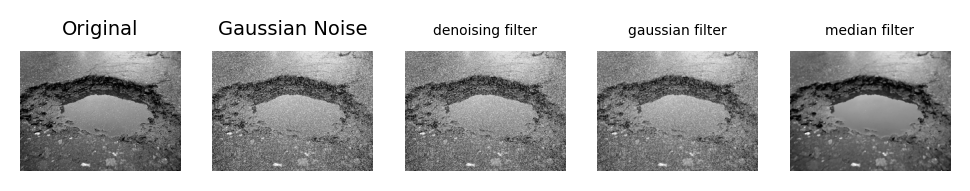

In [70]:
# Generate Gaussian noise
gauss = np.random.normal(0,1,img.size)
gauss = gauss.reshape(img.shape[0],img.shape[1]).astype('uint8')
# Add the Gaussian noise to the image
img_gauss = cv2.add(img,gauss)
#denoising
new_image = cv2.fastNlMeansDenoising(img_gauss,None,10,10)
blurred22=cv2.GaussianBlur(img_gauss,(3,3),1)
med = cv2.medianBlur(img_gauss,5)
# Display the image
fig=plt.figure(dpi=200)

fig.add_subplot(1,5,1)
plt.imshow(img,cmap='gray')
plt.axis("off")
plt.title("Original",fontsize=7)

fig.add_subplot(1,5,2)
plt.imshow(img_gauss,cmap='gray')
plt.axis("off")
plt.title("Gaussian Noise",fontsize=7)

fig.add_subplot(1,5,3)
plt.imshow(new_image,cmap='gray')
plt.axis("off")
plt.title("denoising filter",fontsize=5)

fig.add_subplot(1,5,4)
plt.imshow(blurred22,cmap='gray')
plt.axis("off")
plt.title("gaussian filter",fontsize=5)

fig.add_subplot(1,5,5)
plt.imshow(med,cmap='gray')
plt.axis("off")
plt.title("median filter",fontsize=5)

4) Speckle Noise

Text(0.5, 1.0, 'median filter')

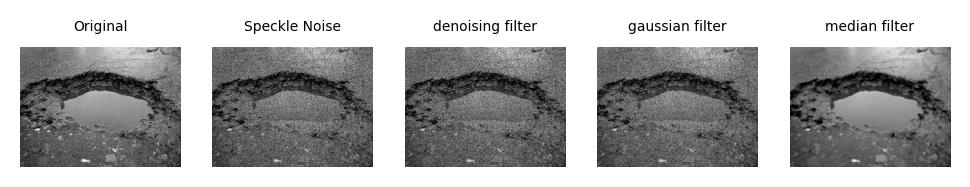

In [71]:
gauss = np.random.normal(0,1,img.size)
gauss = gauss.reshape(img.shape[0],img.shape[1]).astype('uint8')
noise = img + img * gauss
fig=plt.figure(dpi=200)
#denoising
new_image = cv2.fastNlMeansDenoising(noise,None,10,10)
blurred22=cv2.GaussianBlur(noise,(3,3),1)
med = cv2.medianBlur(noise,7)

fig.add_subplot(1,5,1)
plt.imshow(img,cmap='gray')
plt.axis("off")
plt.title("Original",fontsize=5)

fig.add_subplot(1,5,2)
plt.imshow(noise,cmap='gray')
plt.axis("off")
plt.title("Speckle Noise",fontsize=5)

fig.add_subplot(1,5,3)
plt.imshow(new_image,cmap='gray')
plt.axis("off")
plt.title("denoising filter",fontsize=5)

fig.add_subplot(1,5,4)
plt.imshow(blurred22,cmap='gray')
plt.axis("off")
plt.title("gaussian filter",fontsize=5)

fig.add_subplot(1,5,5)
plt.imshow(med,cmap='gray')
plt.axis("off")
plt.title("median filter",fontsize=5)

5) Uniform Noise

Text(0.5, 1.0, 'median filter')

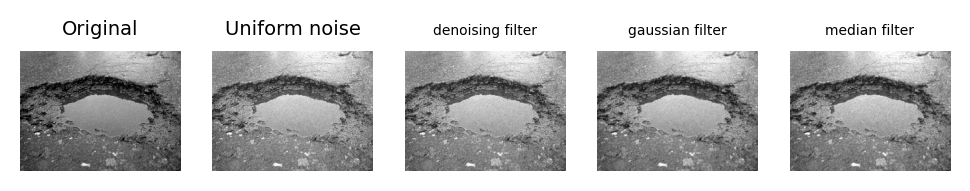

In [72]:
uni_noise=np.zeros((480,640),dtype=np.uint8)
cv2.randu(uni_noise,0,255)
uni_noise=(uni_noise*0.3).astype(np.uint8)
un_img=cv2.add(img,uni_noise)
#denoising
new_image = cv2.fastNlMeansDenoising(un_img,None,10,10)
blurred22=cv2.GaussianBlur(un_img,(3,3),1)
blurred2=cv2.medianBlur(un_img,3)
#cv2_imshow(blurred22)
fig=plt.figure(dpi=200)

fig.add_subplot(1,5,1)
plt.imshow(img,cmap='gray')
plt.axis("off")
plt.title("Original",fontsize=7)

fig.add_subplot(1,5,2)
plt.imshow(un_img,cmap='gray')
plt.axis("off")
plt.title("Uniform noise",fontsize=7)

fig.add_subplot(1,5,3)
plt.imshow(new_image,cmap='gray')
plt.axis("off")
plt.title("denoising filter",fontsize=5)

fig.add_subplot(1,5,4)
plt.imshow(blurred22,cmap='gray')
plt.axis("off")
plt.title("gaussian filter",fontsize=5)

fig.add_subplot(1,5,5)
plt.imshow(blurred2,cmap='gray')
plt.axis("off")
plt.title("median filter",fontsize=5)

MORPHOLOGICAL PROCESSING:

1. Erosion
2. Dilation
3. Opening
4. Closing
5. Tophat
6. BlackHat
7. Gradient

Original Image


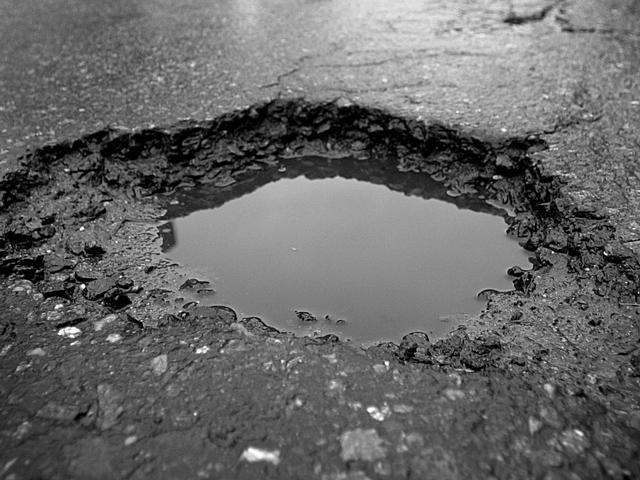

Erosion Image


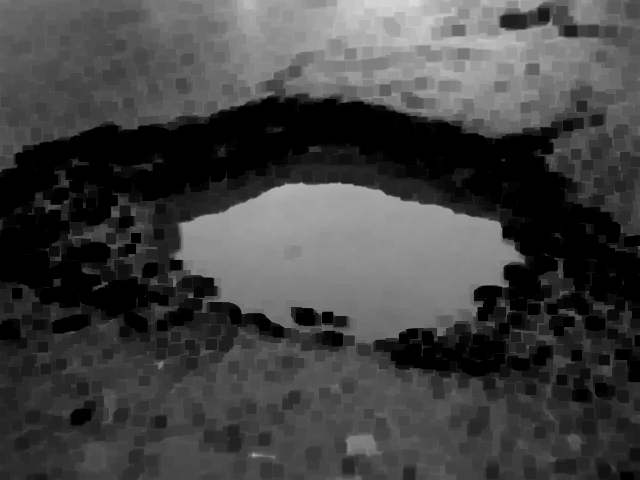

Dilation Image


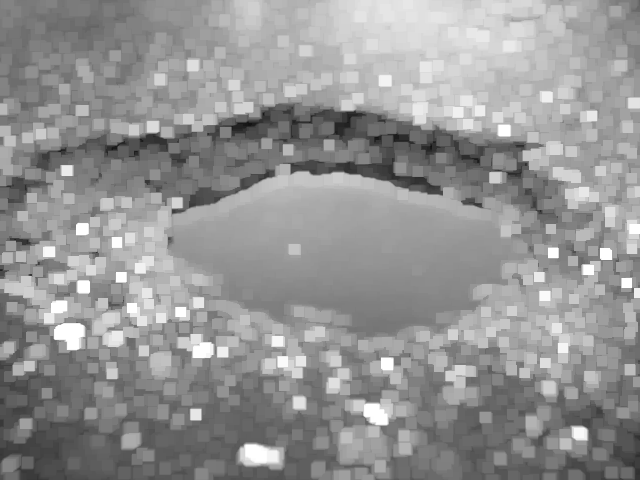

In [74]:
# Reading the input image
img = cv2.imread('/content/drive/MyDrive/Potholes Dataset/6.jpg', 0)

# Taking a matrix of size 5 as the kernel
kernel = np.ones((10,10), np.uint8) # structuring element
img_erosion = cv2.erode(img, kernel, iterations=1)
img_dilation = cv2.dilate(img, kernel, iterations=1)
print("Original Image")
cv2_imshow(img)
print("Erosion Image")
cv2_imshow(img_erosion)
print("Dilation Image")
cv2_imshow(img_dilation)


Opening


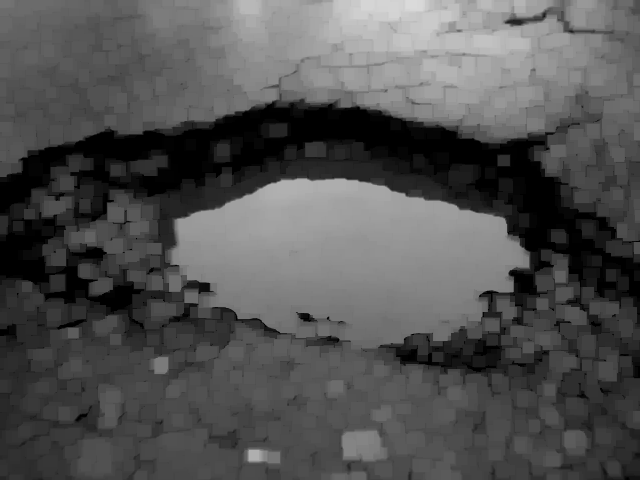

Closing


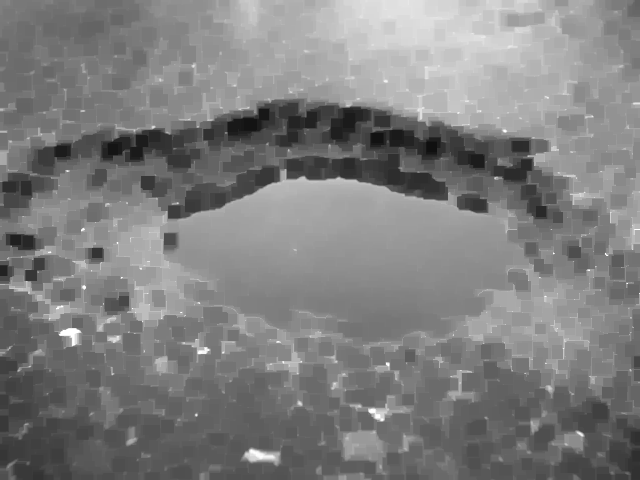

In [75]:
# Define the structuring element
kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(10,10))

# Apply the opening operation
#erosion->dilation
opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
# Apply the closing operation
#dilation->erosion
closing = cv2.morphologyEx(img, cv2.MORPH_CLOSE, kernel)
print("Opening")
cv2_imshow(opening)
print("Closing")
cv2_imshow(closing)

Gradient Operation 1


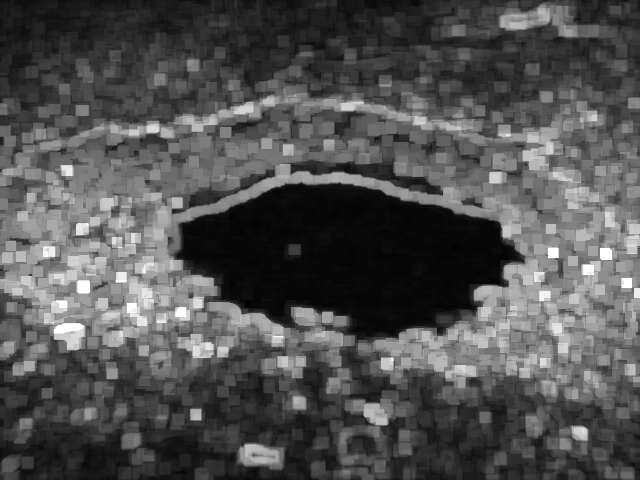

Gradient Operation 2


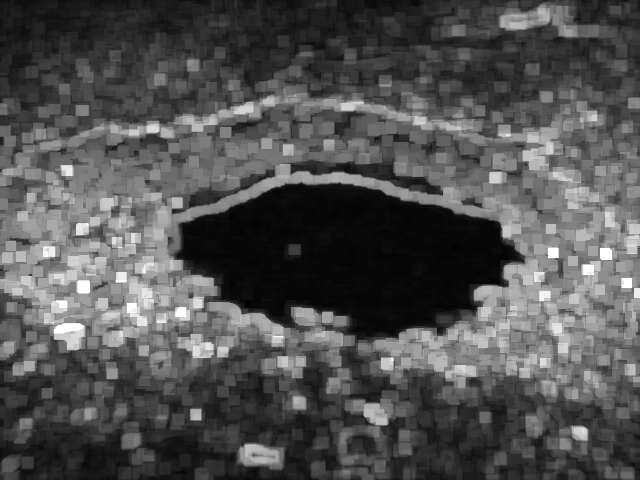

In [76]:
# Approach-1: Perform erosion and dilation separately and then subtract
erosion = cv2.erode(img, kernel, iterations = 1)
dilation = cv2.dilate(img, kernel, iterations=1)
gradient1 = dilation - erosion

# Approach-2: Use cv2.morphologyEx()
gradient = cv2.morphologyEx(img, cv2.MORPH_GRADIENT, kernel)
print("Gradient Operation 1")
cv2_imshow(gradient1)
print("Gradient Operation 2")
cv2_imshow(gradient)

Tophat


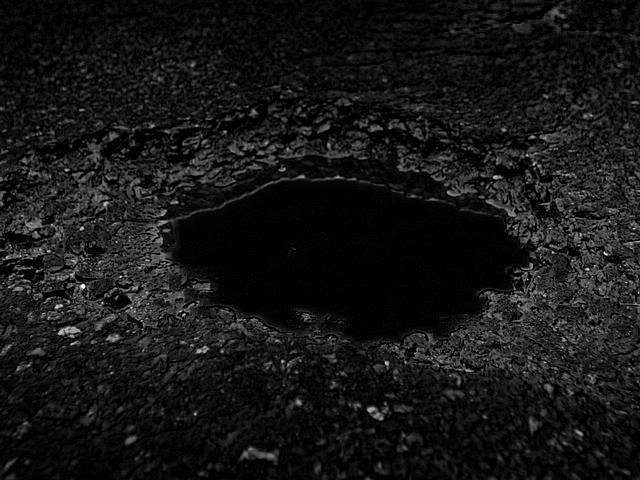

Blackhat


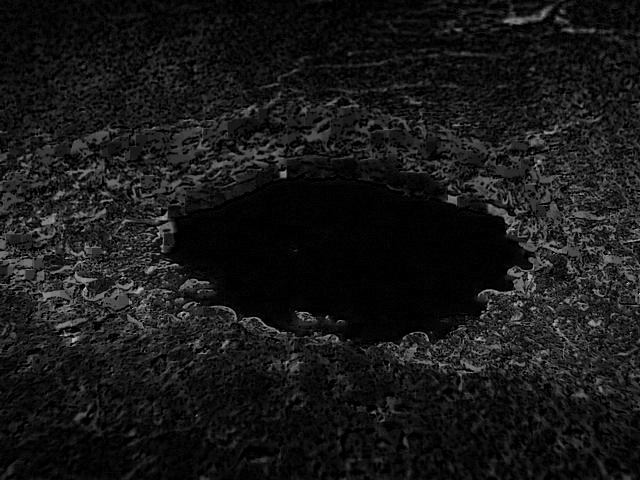

In [77]:
# Structuring element
kernel = cv2.getStructuringElement(cv2.MORPH_RECT,(10,10))
# Apply the top hat transform
#img-opening
tophat = cv2.morphologyEx(img, cv2.MORPH_TOPHAT, kernel)
# Apply the black hat transform
#img-closing
blackhat = cv2.morphologyEx(img, cv2.MORPH_BLACKHAT, kernel)
print("Tophat")
cv2_imshow(tophat)
print("Blackhat")
cv2_imshow(blackhat)

IMAGE QUALITY EVALUATION METRICES
1. PSNR
2. SSIM

In [80]:
from math import log10, sqrt

def PSNR(original, compressed):
	mse = np.mean((original - compressed) ** 2)
	if(mse == 0): # MSE is zero means no noise is present in the signal .
				# Therefore PSNR have no importance.
		return 100
	max_pixel = 255.0
	psnr = 20 * log10(max_pixel / sqrt(mse))
	return psnr
img = cv2.imread('/content/drive/MyDrive/Potholes Dataset/6.jpg',0)
print(f"PSNR value of Erosion {PSNR(img,img_erosion)} dB")
print(f"PSNR value of Dilation {PSNR(img,img_dilation)} dB")
print(f"PSNR value of Opening {PSNR(img,opening)} dB")
print(f"PSNR value of Closing {PSNR(img,closing)} dB")
print(f"PSNR value of Gradient {PSNR(img,gradient)} dB")
print(f"PSNR value of Tophat {PSNR(img,tophat)} dB")
print(f"PSNR value of Blackhat {PSNR(img,blackhat)} dB")

PSNR value of Erosion 28.293689213025125 dB
PSNR value of Dilation 28.106105472064232 dB
PSNR value of Opening 29.015825000721094 dB
PSNR value of Closing 28.767846541852272 dB
PSNR value of Gradient 27.960425493464214 dB
PSNR value of Tophat 28.091637372259722 dB
PSNR value of Blackhat 27.84791930811968 dB


In [81]:
import math
import numpy as np
import cv2

def ssim(img1, img2):
    C1 = (0.01 * 255)**2
    C2 = (0.03 * 255)**2

    img1 = img1.astype(np.float64)
    img2 = img2.astype(np.float64)
    kernel = cv2.getGaussianKernel(11, 1.5)
    window = np.outer(kernel, kernel.transpose())

    mu1 = cv2.filter2D(img1, -1, window)[5:-5, 5:-5]  # valid
    mu2 = cv2.filter2D(img2, -1, window)[5:-5, 5:-5]
    mu1_sq = mu1**2
    mu2_sq = mu2**2
    mu1_mu2 = mu1 * mu2
    sigma1_sq = cv2.filter2D(img1**2, -1, window)[5:-5, 5:-5] - mu1_sq
    sigma2_sq = cv2.filter2D(img2**2, -1, window)[5:-5, 5:-5] - mu2_sq
    sigma12 = cv2.filter2D(img1 * img2, -1, window)[5:-5, 5:-5] - mu1_mu2

    ssim_map = ((2 * mu1_mu2 + C1) * (2 * sigma12 + C2)) / ((mu1_sq + mu2_sq + C1) *
                                                            (sigma1_sq + sigma2_sq + C2))
    return ssim_map.mean()


def calculate_ssim(img1, img2):
    '''calculate SSIM
    the same outputs as MATLAB's
    img1, img2: [0, 255]
    '''
    if not img1.shape == img2.shape:
        raise ValueError('Input images must have the same dimensions.')
    if img1.ndim == 2:
        return ssim(img1, img2)
    elif img1.ndim == 3:
        if img1.shape[2] == 3:
            ssims = []
            for i in range(3):
                ssims.append(ssim(img1, img2))
            return np.array(ssims).mean()
        elif img1.shape[2] == 1:
            return ssim(np.squeeze(img1), np.squeeze(img2))
    else:
        raise ValueError('Wrong input image dimensions.')
print(f"SSIM value of Erosion {calculate_ssim(img,img_erosion)} dB")
print(f"SSIM value of Dilation {calculate_ssim(img,img_dilation)} dB")
print(f"SSIM value of Opening {calculate_ssim(img,opening)} dB")
print(f"SSIM value of Closing {calculate_ssim(img,closing)} dB")
print(f"SSIM value of Gradient {calculate_ssim(img,gradient)} dB")
print(f"SSIM value of Tophat {calculate_ssim(img,tophat)} dB")
print(f"SSIM value of Blackhat {calculate_ssim(img,blackhat)} dB")

SSIM value of Erosion 0.32193777617042096 dB
SSIM value of Dilation 0.3299685354946545 dB
SSIM value of Opening 0.4403284243705252 dB
SSIM value of Closing 0.4637408415426465 dB
SSIM value of Gradient 0.14393488981137312 dB
SSIM value of Tophat 0.4054947398597473 dB
SSIM value of Blackhat -0.24838023770388662 dB


* By observing all the morphological feature processing for the image Opening and Closing gives better results. 
* Image evaluation is done using PSNR and SSIM image quality evaluation metrices.


EDGE DETECTORS
1. LAPLACIAN
2. CANNY
3. SOBEL
4. PERWITT
5. ROBERT
6. MAR- HILDRETH( Laplacian of gaussian)

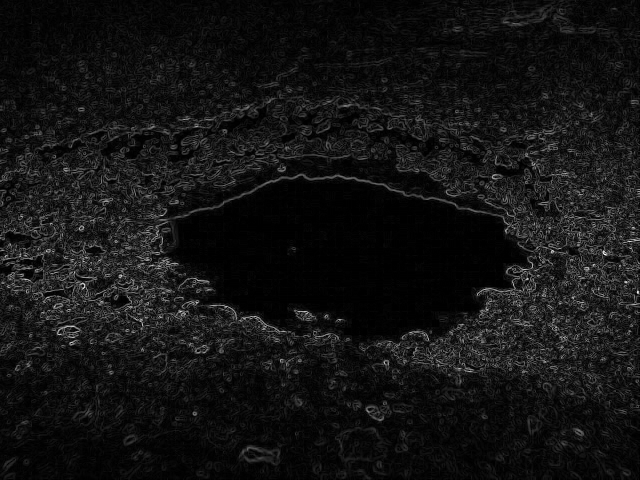

In [82]:
#ROBERT EDGE DETECTION
from scipy import ndimage
img = cv2.imread("/content/drive/MyDrive/Potholes Dataset/6.jpg",0).astype('float64')
img/=255.0
roberts_cross_v = np.array( [[1, 0 ],
							[0,-1 ]] )

roberts_cross_h = np.array( [[ 0, 1 ],
							[ -1, 0 ]] )

vertical = ndimage.convolve( img, roberts_cross_v )
horizontal = ndimage.convolve( img, roberts_cross_h )

edged_img = np.sqrt( np.square(horizontal) + np.square(vertical))
edged_img*=255
cv2_imshow(edged_img)


Original Image


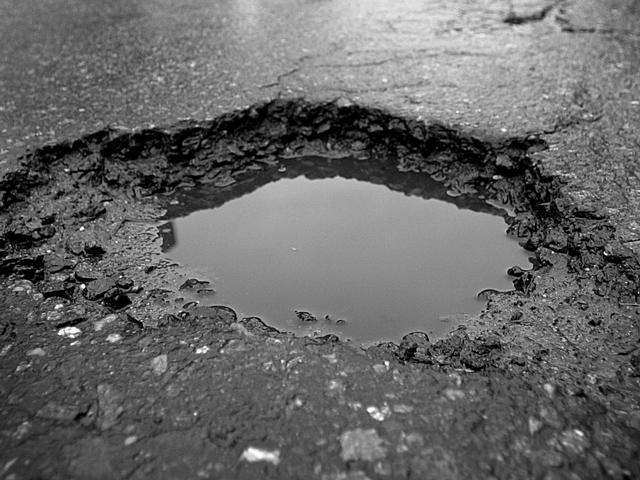

Canny


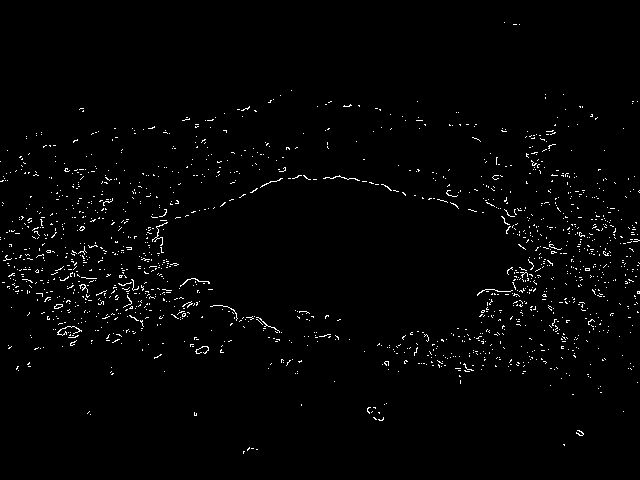

Sobel X


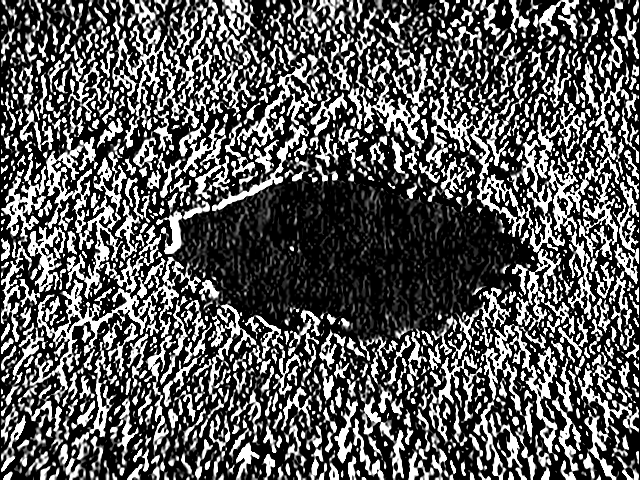

Sobel Y


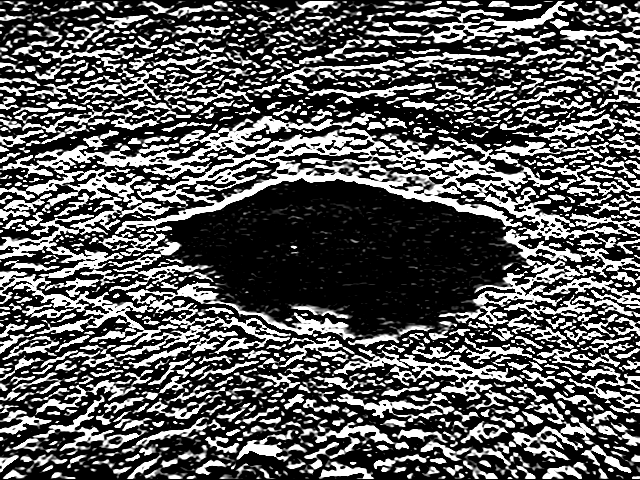

Sobel X+Y


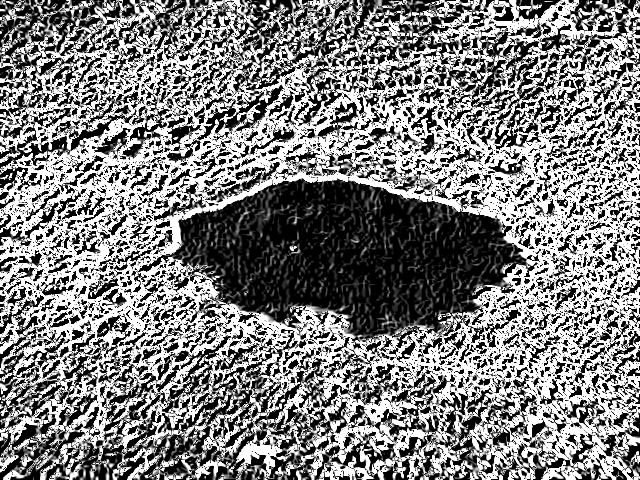

Prewitt X


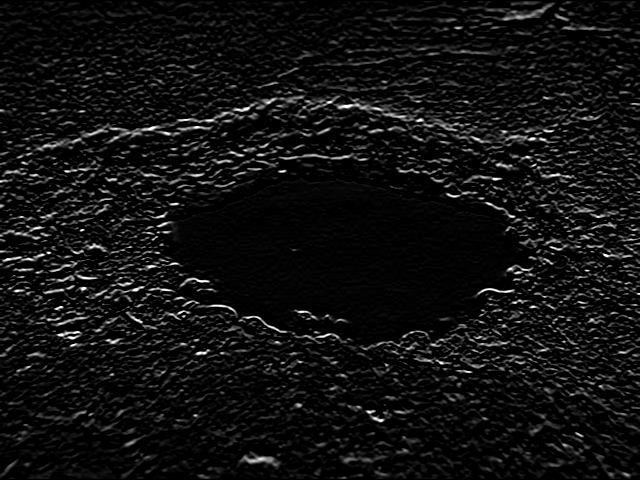

Prewitt Y


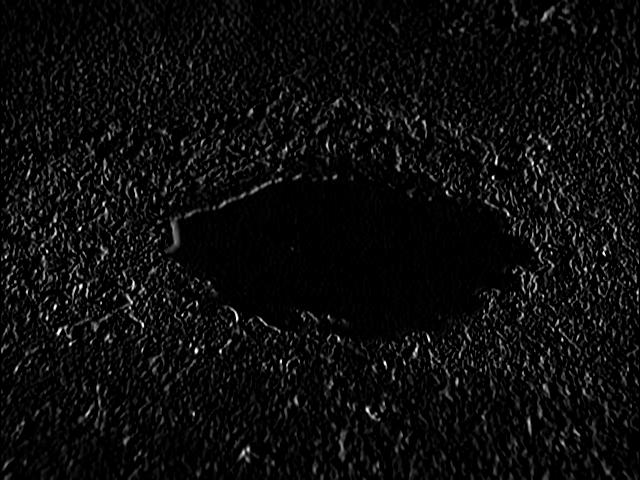

Prewitt X+Y


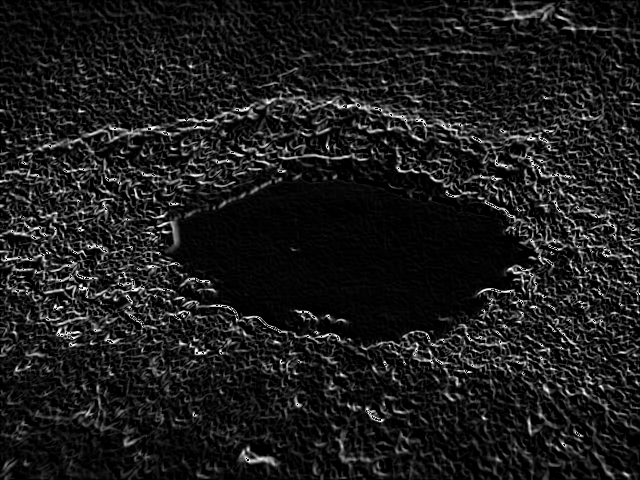

In [83]:
img = cv2.imread('/content/drive/MyDrive/Potholes Dataset/6.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_gaussian = cv2.GaussianBlur(img,(3,3),0)

#canny
img_canny = cv2.Canny(img,450,450)


#sobel
img_sobelx = cv2.Sobel(img_gaussian,cv2.CV_8U,1,0,ksize=5)
img_sobely = cv2.Sobel(img_gaussian,cv2.CV_8U,0,1,ksize=5)
img_sobel = img_sobelx + img_sobely


#prewitt
kernelx = np.array([[1,1,1],[0,0,0],[-1,-1,-1]])
kernely = np.array([[-1,0,1],[-1,0,1],[-1,0,1]])
img_prewittx = cv2.filter2D(img_gaussian, -1, kernelx)
img_prewitty = cv2.filter2D(img_gaussian, -1, kernely)

print("Original Image")
cv2_imshow( img)
print("Canny")
cv2_imshow(img_canny)
print("Sobel X")
cv2_imshow(img_sobelx)
print("Sobel Y")
cv2_imshow( img_sobely)
print("Sobel X+Y")
cv2_imshow( img_sobel)
print("Prewitt X")
cv2_imshow(img_prewittx)
print("Prewitt Y")
cv2_imshow( img_prewitty)
print("Prewitt X+Y")
cv2_imshow(img_prewittx + img_prewitty)



Text(0.5, 1.0, 'LOG')

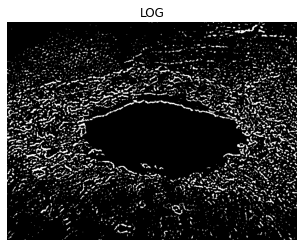

In [84]:
blur = cv2.GaussianBlur(img, (7, 7), 0)

laplacian = cv2.Laplacian(blur, cv2.CV_64F)

# Apply a threshold to the Laplacian image to identify the edges
_, thresh = cv2.threshold(laplacian, 5, 255, cv2.THRESH_BINARY)

# Display the resulting edge-detected image
plt.imshow(thresh, cmap='gray')
plt.axis('off')
plt.title(f"LOG")

In [85]:
from math import log10, sqrt

def PSNR(original, compressed):
	mse = np.mean((original - compressed) ** 2)
	if(mse == 0): # MSE is zero means no noise is present in the signal .
				# Therefore PSNR have no importance.
		return 100
	max_pixel = 255.0
	psnr = 20 * log10(max_pixel / sqrt(mse))
	return psnr

print(f"PSNR value of Canny {PSNR(img,img_canny)} dB")
print(f"PSNR value of Robert {PSNR(img,edged_img)} dB")
print(f"PSNR value of Sobel {PSNR(img,img_sobel)} dB")
print(f"PSNR value of Prewitt {PSNR(img,img_prewittx + img_prewitty)} dB")
print(f"PSNR value of LOG {PSNR(img,thresh)} dB")

PSNR value of Canny 27.948266456935965 dB
PSNR value of Robert 8.104666865310868 dB
PSNR value of Sobel 27.932033985507925 dB
PSNR value of Prewitt 27.933747939776218 dB
PSNR value of LOG 5.870824488109506 dB


In [86]:
print(f"SSIM value of Canny {calculate_ssim(img,img_canny)} ")
print(f"SSIM value of Robert {calculate_ssim(img,edged_img)} ")
print(f"SSIM value of Sobel {calculate_ssim(img,img_sobel)} ")
print(f"SSIM value of Prewitt {calculate_ssim(img,img_prewittx + img_prewitty)} ")
print(f"SSIM value of LOG {calculate_ssim(img,thresh)} ")

SSIM value of Canny 0.008169128598735509 
SSIM value of Robert 0.09210866494510213 
SSIM value of Sobel 0.009239462133417673 
SSIM value of Prewitt 0.05194224613411584 
SSIM value of LOG -0.07534017587461399 


Segmentation

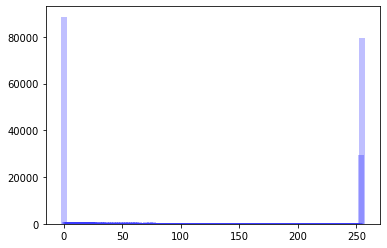

optimal threshold 131


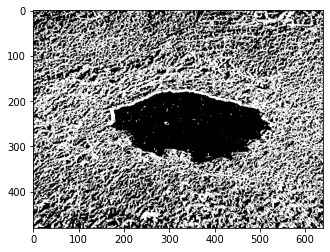

In [87]:
threshold_values = {}
h = [1]


def Hist(img):
   row, col = img.shape 
   y = np.zeros(256)
   for i in range(0,row):
      for j in range(0,col):
         y[img[i,j]] += 1
   x = np.arange(0,256)
   plt.bar(x, y, color='b', width=5, align='center', alpha=0.25)
   plt.show()
   return y


def regenerate_img(img, threshold):
    row, col = img.shape 
    y = np.zeros((row, col))
    for i in range(0,row):
        for j in range(0,col):
            if img[i,j] >= threshold:
                y[i,j] = 255
            else:
                y[i,j] = 0
    return y


   
def countPixel(h):
    cnt = 0
    for i in range(0, len(h)):
        if h[i]>0:
           cnt += h[i]
    return cnt


def wieght(s, e):
    w = 0
    for i in range(s, e):
        w += h[i]
    return w


def mean(s, e):
    m = 0
    w = wieght(s, e)
    for i in range(s, e):
        m += h[i] * i
    
    return m/float(w)


def variance(s, e):
    v = 0
    m = mean(s, e)
    w = wieght(s, e)
    for i in range(s, e):
        v += ((i - m) **2) * h[i]
    v /= w
    return v
            

def threshold(h):
    cnt = countPixel(h)
    for i in range(1, len(h)):
        vb = variance(0, i)
        wb = wieght(0, i) / float(cnt)
        mb = mean(0, i)
        
        vf = variance(i, len(h))
        wf = wieght(i, len(h)) / float(cnt)
        mf = mean(i, len(h))
        
        V2w = wb * (vb) + wf * (vf)
        V2b = wb * wf * (mb - mf)**2
        
        fw = open("trace.txt", "a")
        fw.write('T='+ str(i) + "\n")

        fw.write('Wb='+ str(wb) + "\n")
        fw.write('Mb='+ str(mb) + "\n")
        fw.write('Vb='+ str(vb) + "\n")
        
        fw.write('Wf='+ str(wf) + "\n")
        fw.write('Mf='+ str(mf) + "\n")
        fw.write('Vf='+ str(vf) + "\n")

        fw.write('within class variance='+ str(V2w) + "\n")
        fw.write('between class variance=' + str(V2b) + "\n")
        fw.write("\n")
        
        if not math.isnan(V2w):
            threshold_values[i] = V2w


def get_optimal_threshold():
    min_V2w = min(threshold_values.values())
    optimal_threshold = [k for k, v in threshold_values.items() if v == min_V2w]
    print( 'optimal threshold', optimal_threshold[0])
    return optimal_threshold[0]


img = np.asarray(img_sobel)

h = Hist(img)
threshold(h)
op_thres = get_optimal_threshold()

res = regenerate_img(img, op_thres)
plt.imshow(res,cmap='gray')

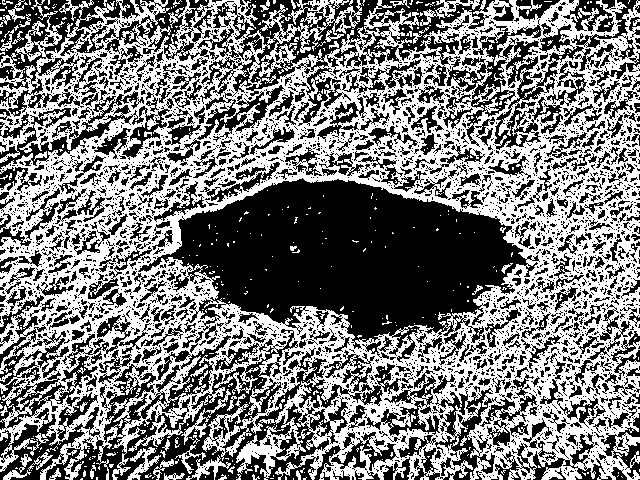

In [88]:
# Otsu thresholding type on an image
img = img_sobel

# applying Otsu thresholding
# as an extra flag in binary
# thresholding	
ret, thresh1 = cv2.threshold(img, 50, 255, cv2.THRESH_BINARY +
											cv2.THRESH_OTSU)	

# the window showing output image		
# with the corresponding thresholding		
# techniques applied to the input image	
cv2_imshow(thresh1)		
	
# De-allocate any associated memory usage		
if cv2.waitKey(0) & 0xff == 27:
	cv2.destroyAllWindows()	


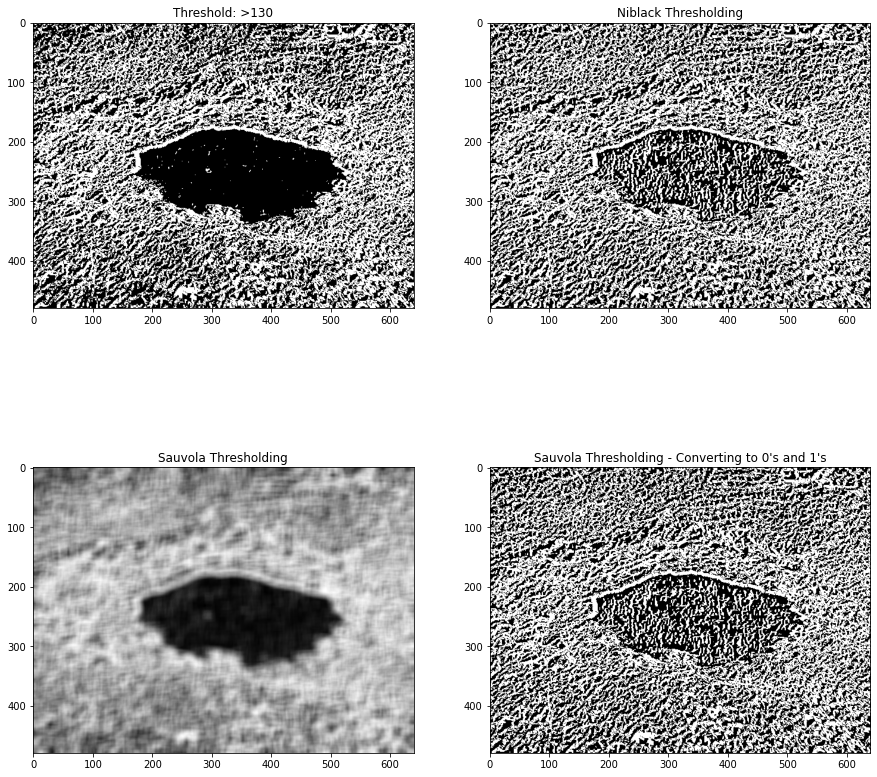

In [89]:
# Importing necessary libraries
from skimage import data
from skimage import filters
from skimage.color import rgb2gray
import matplotlib.pyplot as plt

# Setting plot size to 15, 15
plt.figure(figsize=(15, 15))
img = img_sobel
# Sample Image of scikit-image package

# Computing Otsu's thresholding value
threshold = filters.threshold_otsu(img)

# Computing binarized values using the obtained
# threshold
thrsgt = (img > threshold)*1
plt.subplot(2,2,1)
plt.title("Threshold: >"+str(threshold))

# Displaying the binarized image
plt.imshow(thrsgt, cmap = "gray")

# Computing Ni black's local pixel
# threshold values for every pixel
threshold = filters.threshold_niblack(img)

# Computing binarized values using the obtained
# threshold
thrsnibl = (img > threshold)*1
plt.subplot(2,2,2)
plt.title("Niblack Thresholding")

# Displaying the binarized image
plt.imshow(thrsnibl, cmap = "gray")

# Computing Sauvola's local pixel threshold
# values for every pixel - Not Binarized
thshsau = filters.threshold_sauvola(img)
plt.subplot(2,2,3)
plt.title("Sauvola Thresholding")

# Displaying the local threshold values
plt.imshow(thshsau, cmap = "gray")

# Computing Sauvola's local pixel
# threshold values for every pixel - Binarized
trsh01 = (img > thshsau)*1
plt.subplot(2,2,4)
plt.title("Sauvola Thresholding - Converting to 0's and 1's")

# Displaying the binarized image
plt.imshow(trsh01, cmap = "gray")


Text(0.5, 1.0, 'Chan-Vese segmentation')

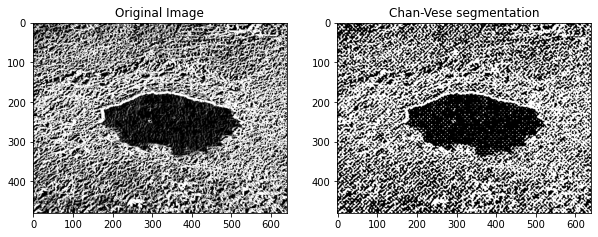

In [90]:
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from skimage import data, img_as_float
from skimage.segmentation import chan_vese
fig, axes = plt.subplots(1, 2, figsize=(10, 10))

# Sample Image of scikit-image package
img = img_sobel

# Computing the Chan VESE segmentation technique
img2 = chan_vese(img,
									max_iter=10,
									extended_output=True)

ax = axes.flatten()

# Plotting the original image
ax[0].imshow(img, cmap="gray")
ax[0].set_title("Original Image")

# Plotting the segmented - 100 iterations image
ax[1].imshow(img2[0], cmap="gray")
title = "Chan-Vese segmentation"

ax[1].set_title(title)


In [91]:
print(f"SSIM value of Optimal threshold {calculate_ssim(img,res)} dB")
print(f"SSIM value of Otsu threshold {calculate_ssim(img,thresh1)} dB")
print(f"SSIM value of Niblack threshold {calculate_ssim(img,thrsnibl)} dB")
print(f"SSIM value of souvola threshold {calculate_ssim(img,thshsau)} dB")
print(f"SSIM value of Chan-vese segmentation {calculate_ssim(img,img2[0])} dB")

SSIM value of Optimal threshold 0.8133433600234268 dB
SSIM value of Otsu threshold 0.8133433600234268 dB
SSIM value of Niblack threshold 0.008771639692297077 dB
SSIM value of souvola threshold 0.024167568000391434 dB
SSIM value of Chan-vese segmentation 0.007537010455321924 dB
